In [4]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import os
import numpy as np
import cv2
# from custom_dataset import CustomDataset, ResidualBlock, ResNet,CustomResNet50, GCN

import plotly.graph_objects as go
# from torch_geometric.nn import MLP
from pytorch_metric_learning.losses import NTXentLoss
from torch.utils.data import random_split
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm

In [5]:
cnn_values=np.load("outputs_cnn.npy").squeeze()
song_names=label_values=pd.read_csv("filenames.csv",header=None).squeeze()

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/threadpoolctl.py:1010: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


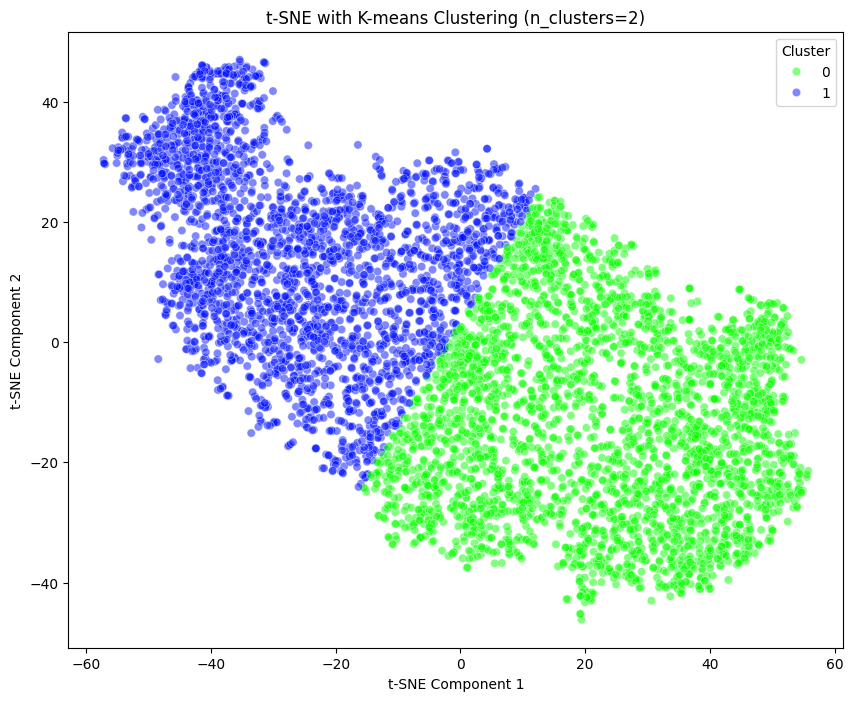

Silhouette Score for n_clusters=2: 0.4720141887664795


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


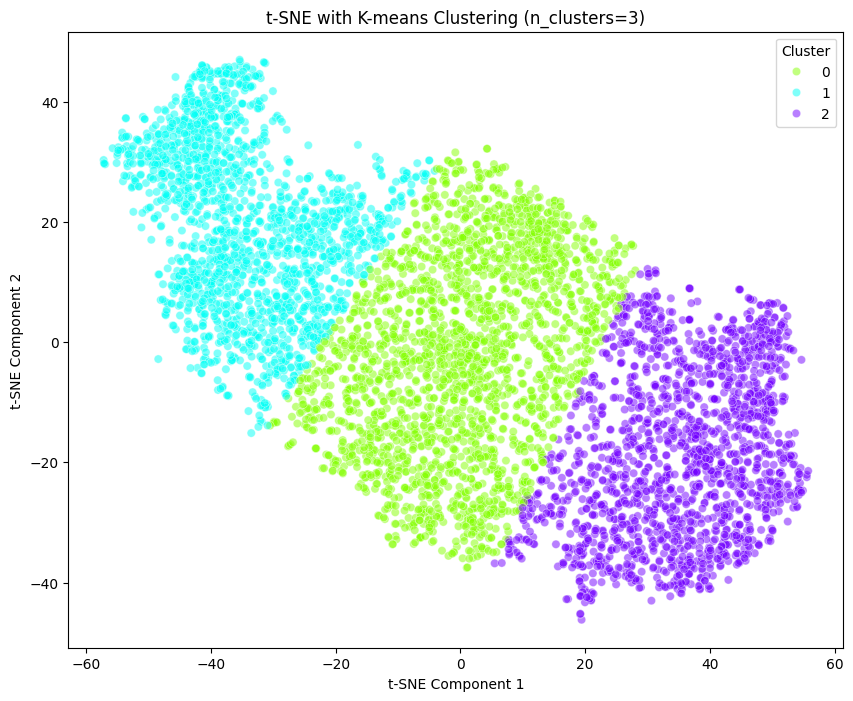

Silhouette Score for n_clusters=3: 0.418274462223053


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


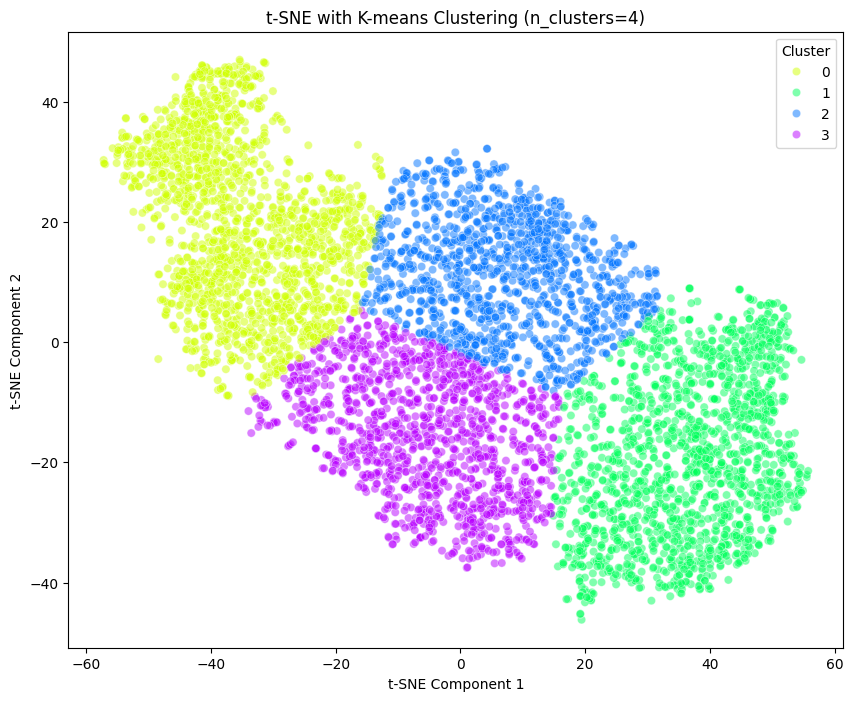

Silhouette Score for n_clusters=4: 0.4390401840209961


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


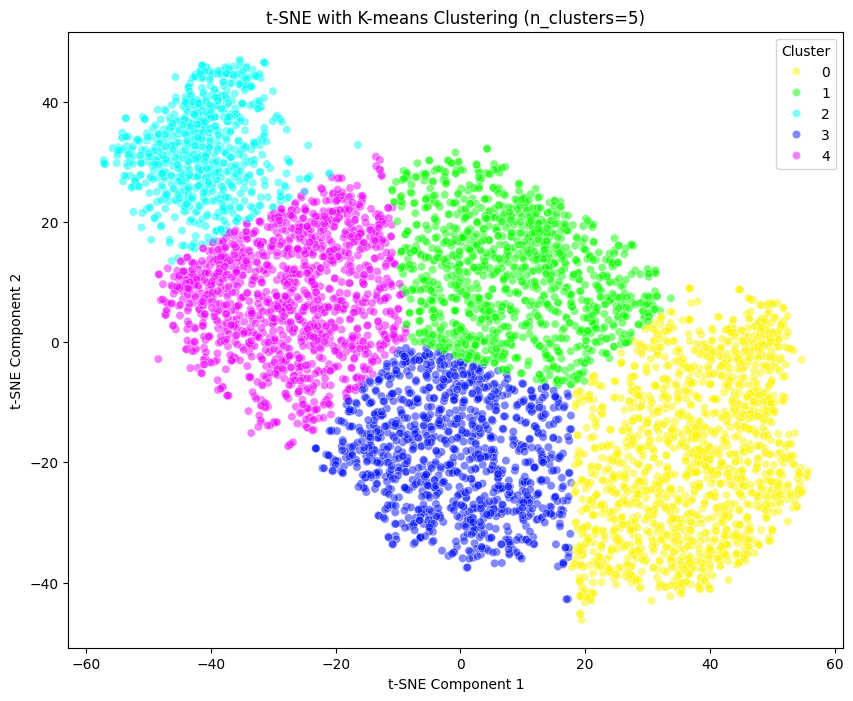

Silhouette Score for n_clusters=5: 0.4201204180717468


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


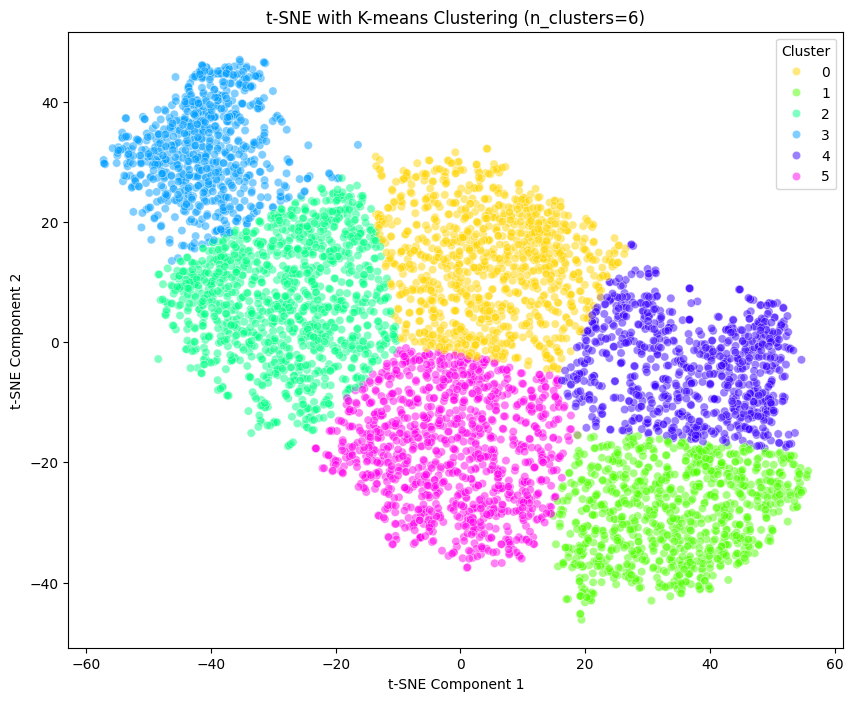

Silhouette Score for n_clusters=6: 0.40291741490364075


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


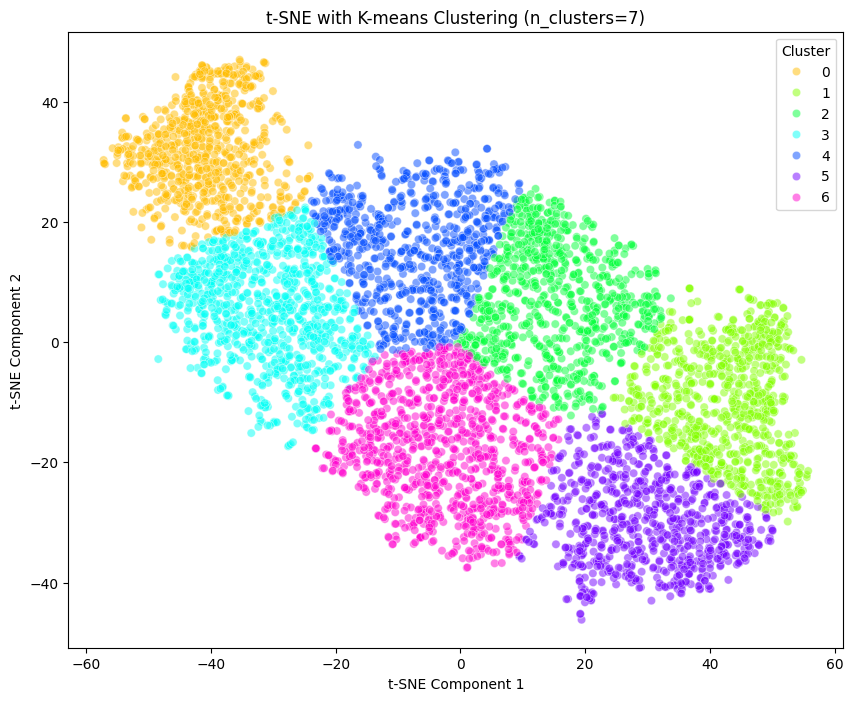

Silhouette Score for n_clusters=7: 0.39114630222320557


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


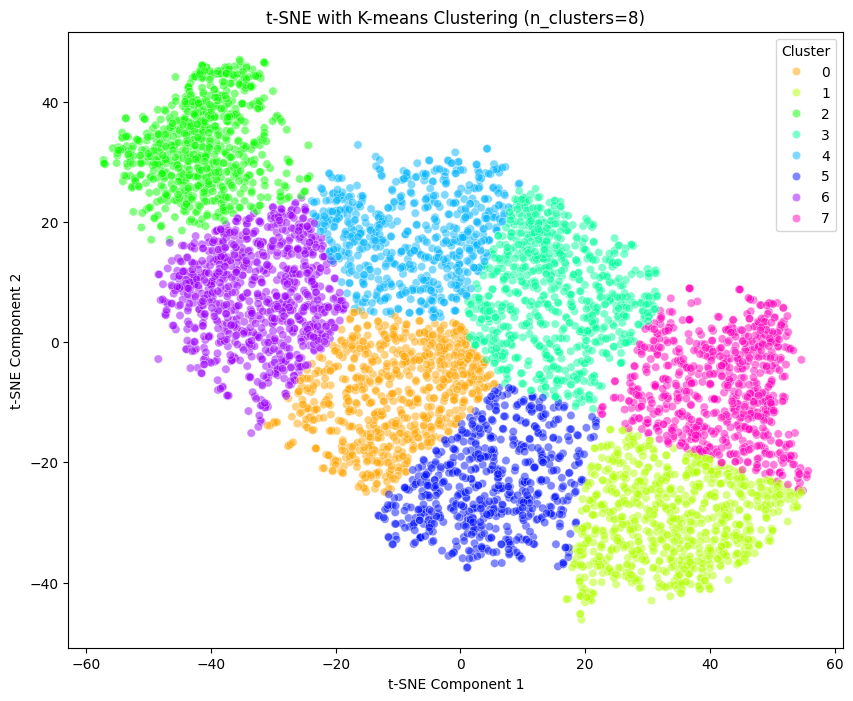

Silhouette Score for n_clusters=8: 0.3805450201034546


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


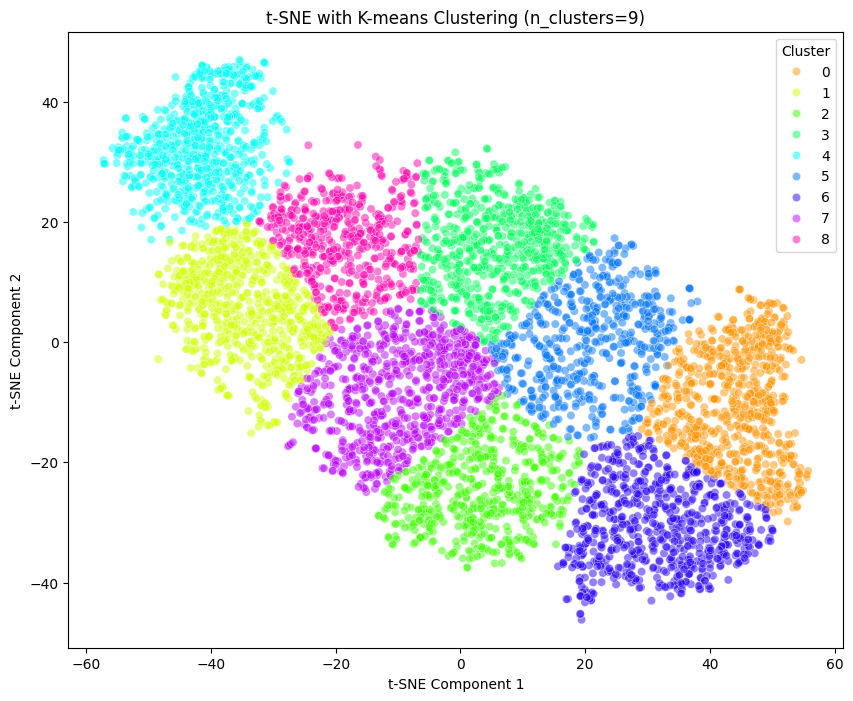

Silhouette Score for n_clusters=9: 0.3848729133605957


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


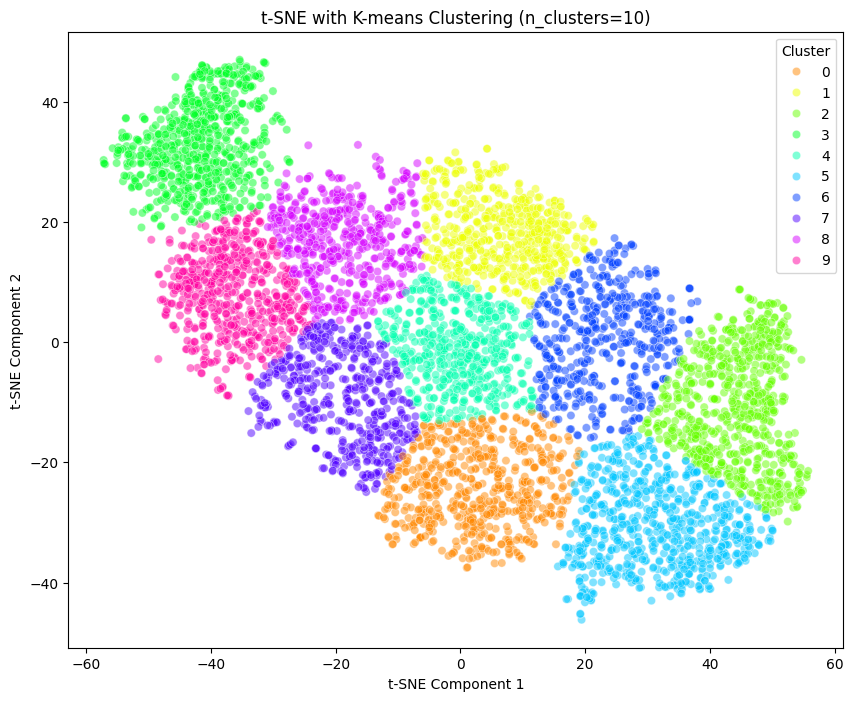

Silhouette Score for n_clusters=10: 0.3946928083896637


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


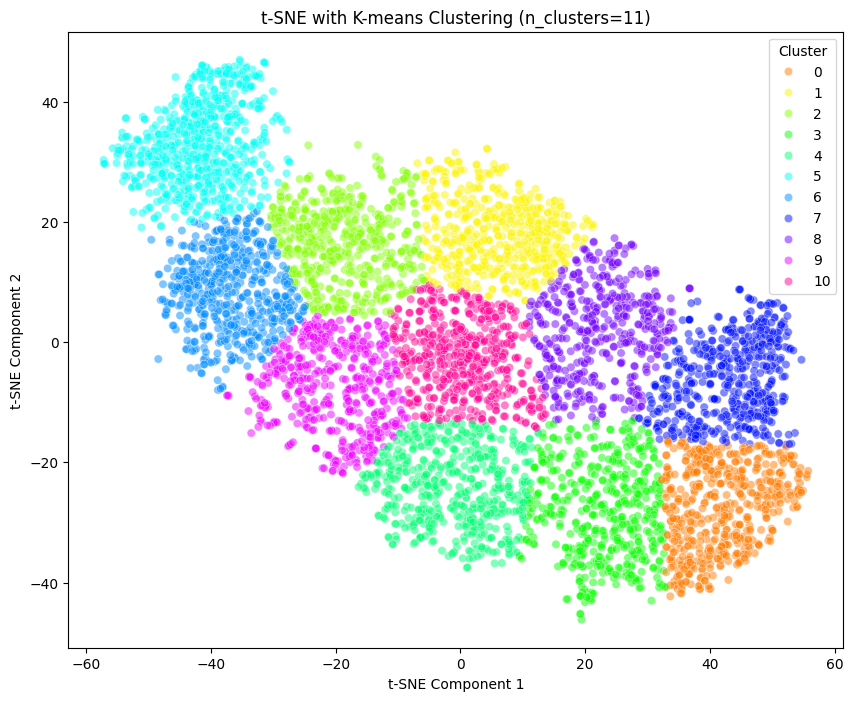

Silhouette Score for n_clusters=11: 0.38812926411628723


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


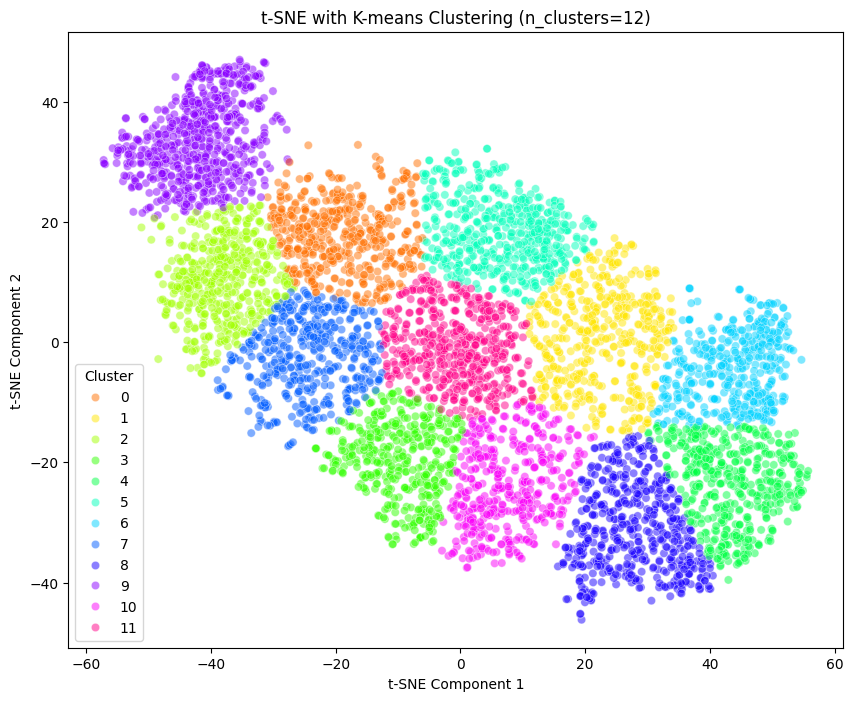

Silhouette Score for n_clusters=12: 0.38348084688186646


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


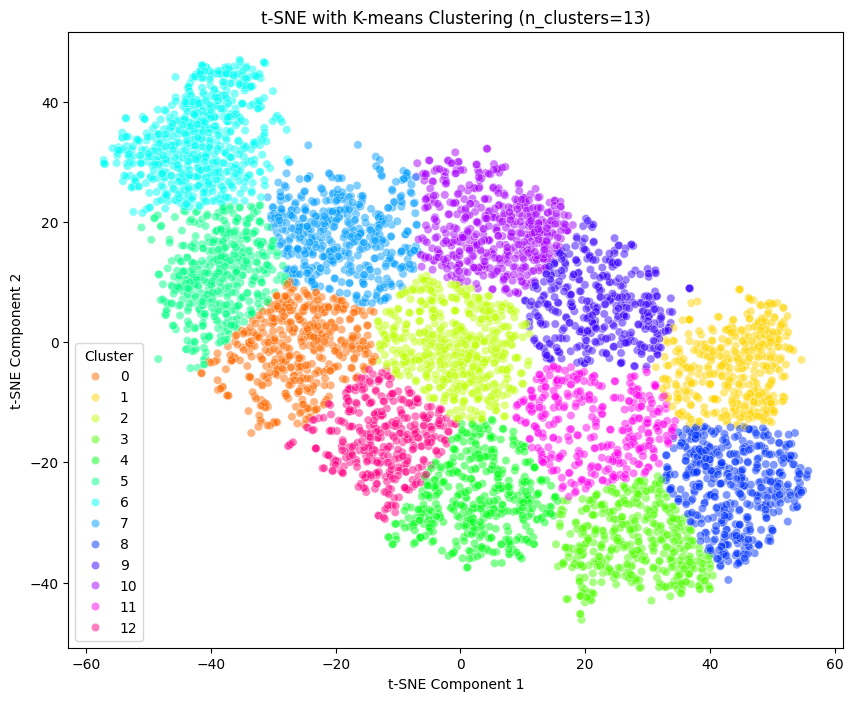

Silhouette Score for n_clusters=13: 0.3859774172306061


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


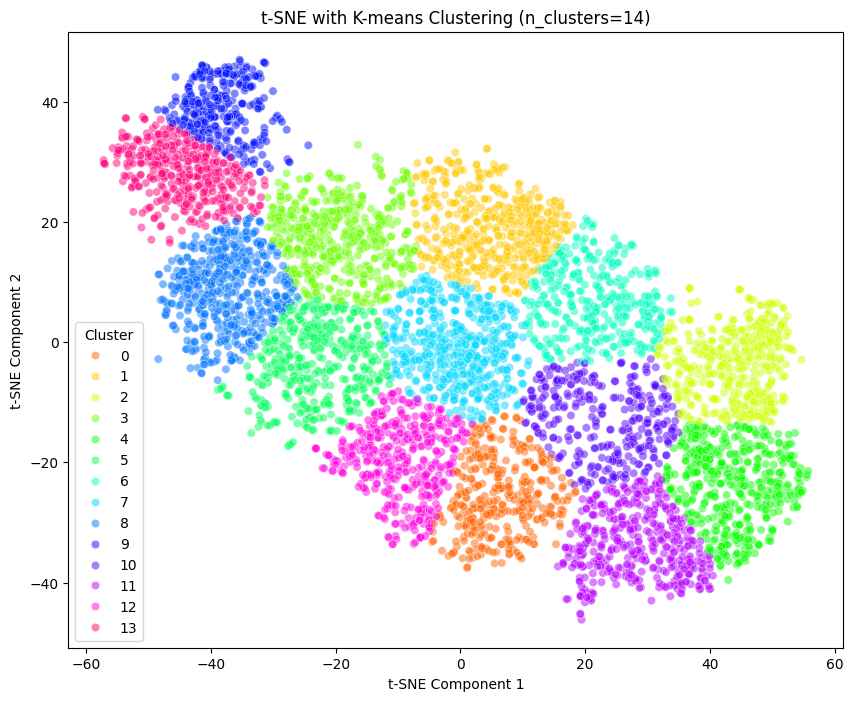

Silhouette Score for n_clusters=14: 0.371637761592865


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


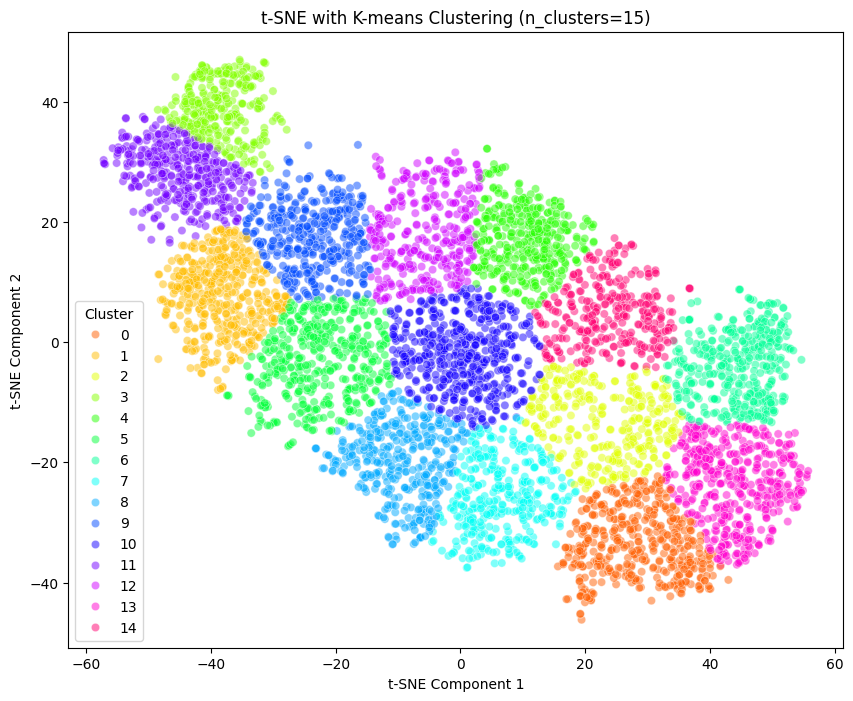

Silhouette Score for n_clusters=15: 0.3680958151817322


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


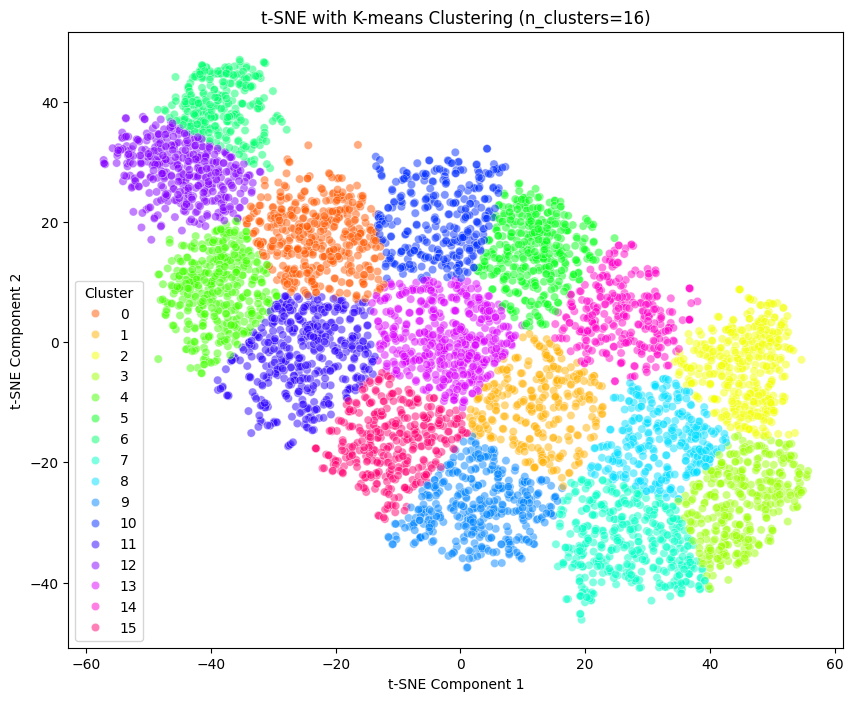

Silhouette Score for n_clusters=16: 0.36961960792541504


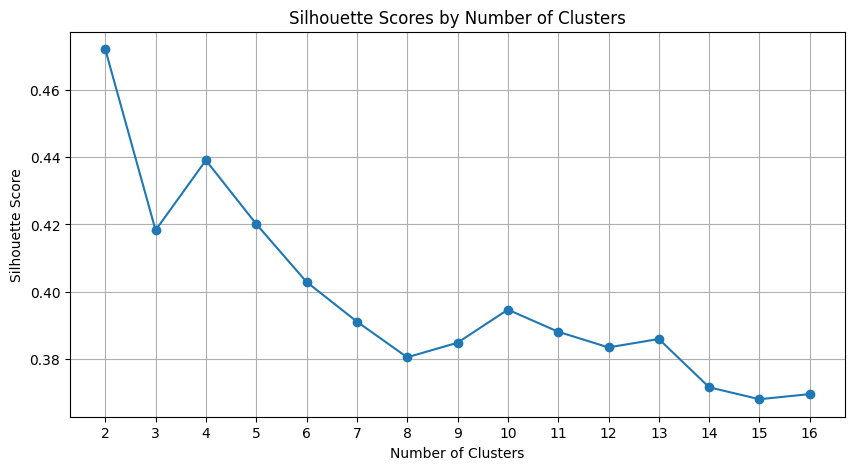

In [6]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import numpy as np

# Assuming cnn_values is already obtained from your model outputs

# Set range of cluster numbers to evaluate
cluster_range = range(2, 17)  # for example, clusters from 2 to 16

# Prepare to collect silhouette scores
silhouette_scores = []

# Run t-SNE just once since it can be computationally expensive
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=50).fit_transform(cnn_values)

for n_clusters in cluster_range:
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
    cluster_labels = kmeans.labels_
    
    # Calculate Silhouette Score
    sil_score = silhouette_score(h_embedded, cluster_labels)
    silhouette_scores.append(sil_score)
    
    # Plotting t-SNE results with cluster colors
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
    plt.title(f"t-SNE with K-means Clustering (n_clusters={n_clusters})")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend(title='Cluster')
    plt.savefig(f'tsne_kmeans_{n_clusters}.png')  # Save the figure as PNG file
    plt.show()
    
    print(f"Silhouette Score for n_clusters={n_clusters}: {sil_score}")

# Plot all silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores by Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(cluster_range)
plt.grid(True)
plt.savefig('silhouette_scores.png')  # Save the silhouette scores plot
plt.show()


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/threadpoolctl.py:1010: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


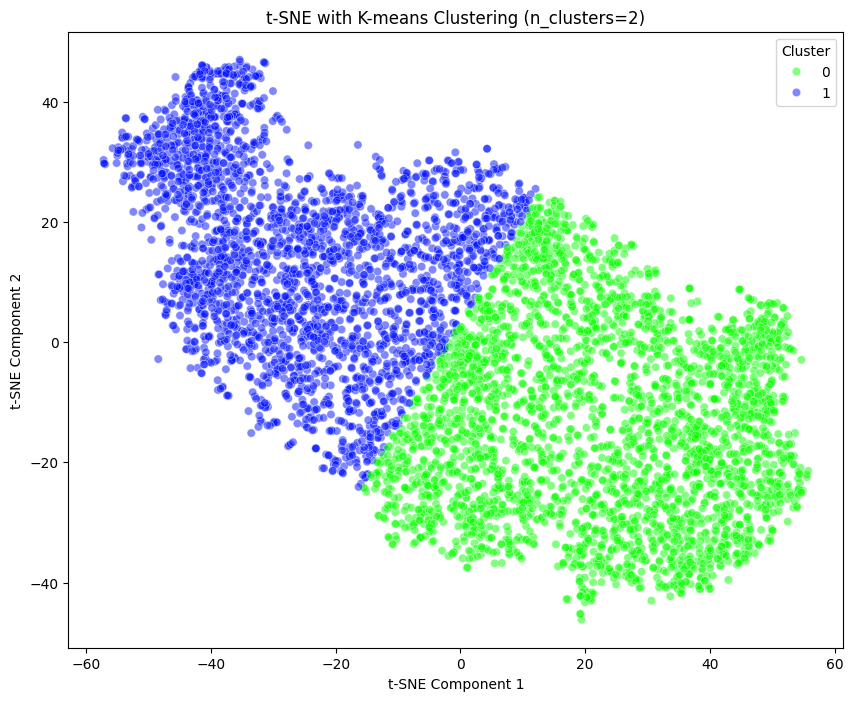

Silhouette Score for n_clusters=2: 0.4720141887664795


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


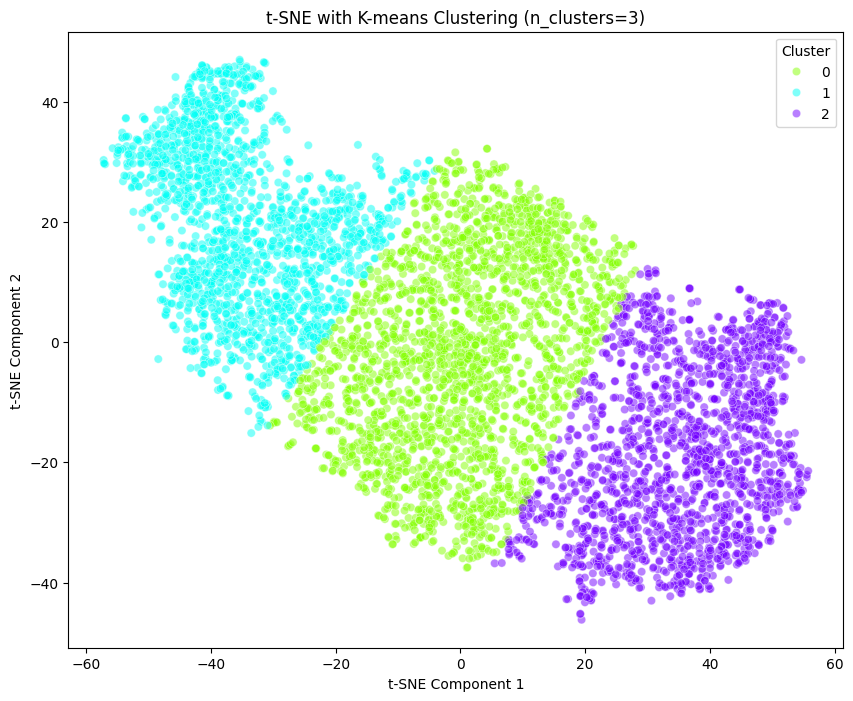

Silhouette Score for n_clusters=3: 0.418274462223053


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


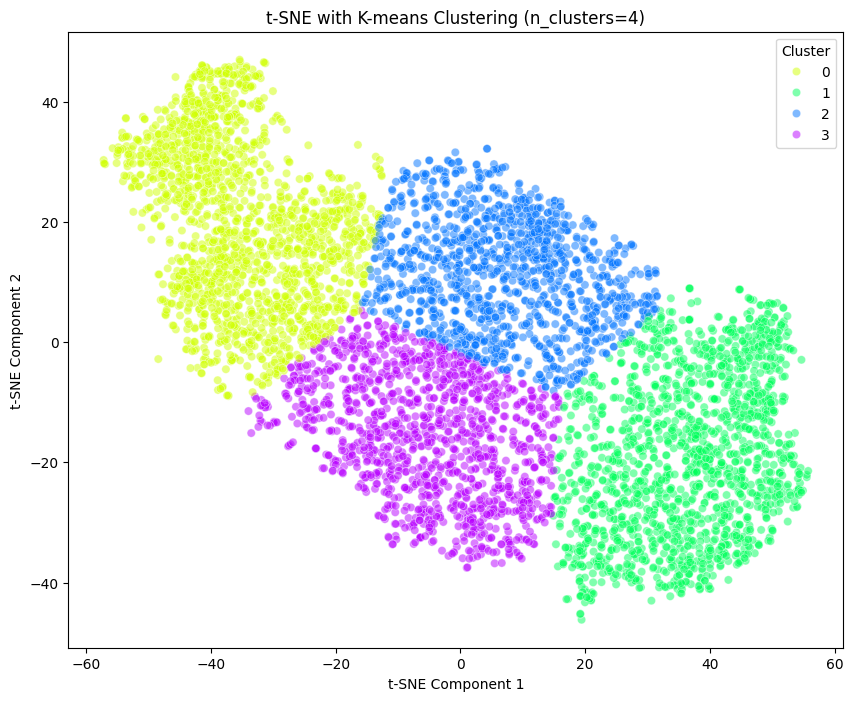

Silhouette Score for n_clusters=4: 0.4390401840209961


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


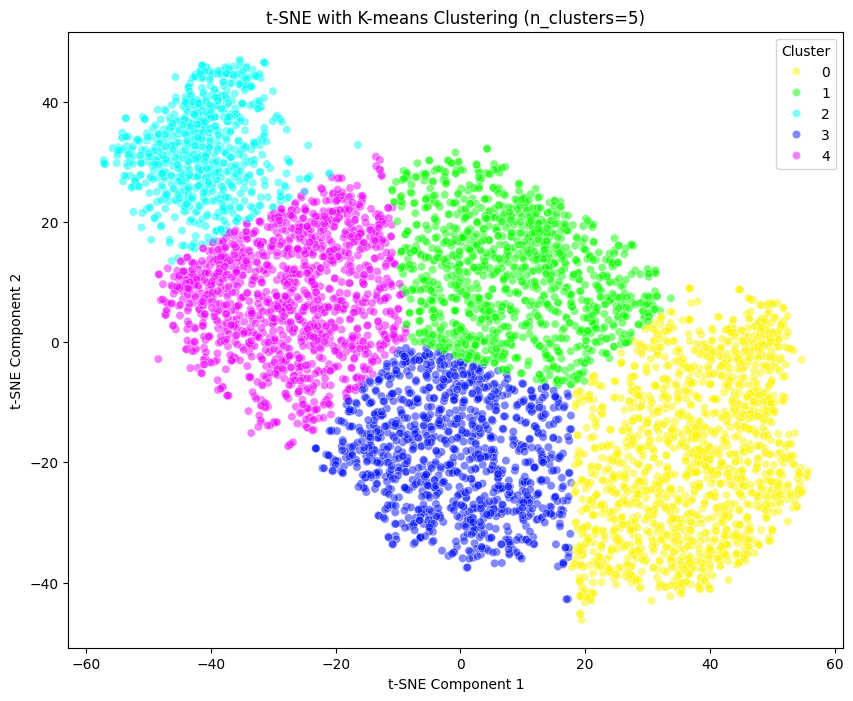

Silhouette Score for n_clusters=5: 0.4201204180717468


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


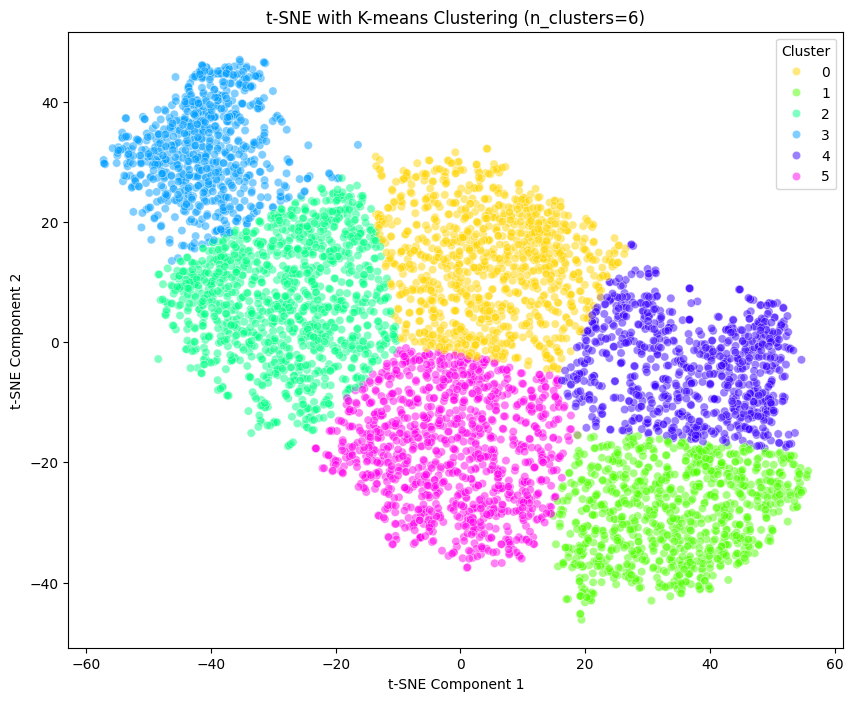

Silhouette Score for n_clusters=6: 0.40291741490364075


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


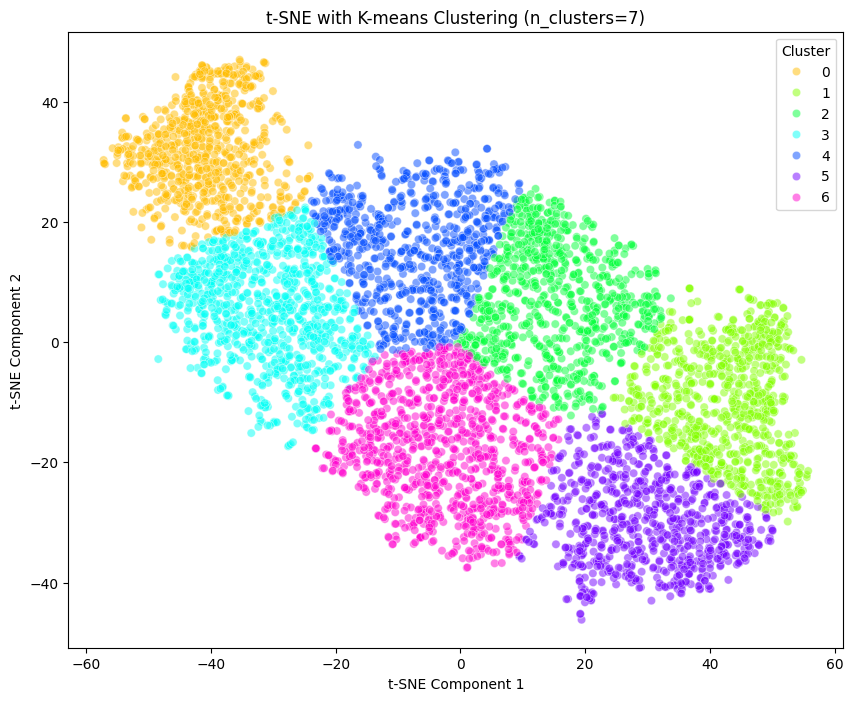

Silhouette Score for n_clusters=7: 0.39114630222320557


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


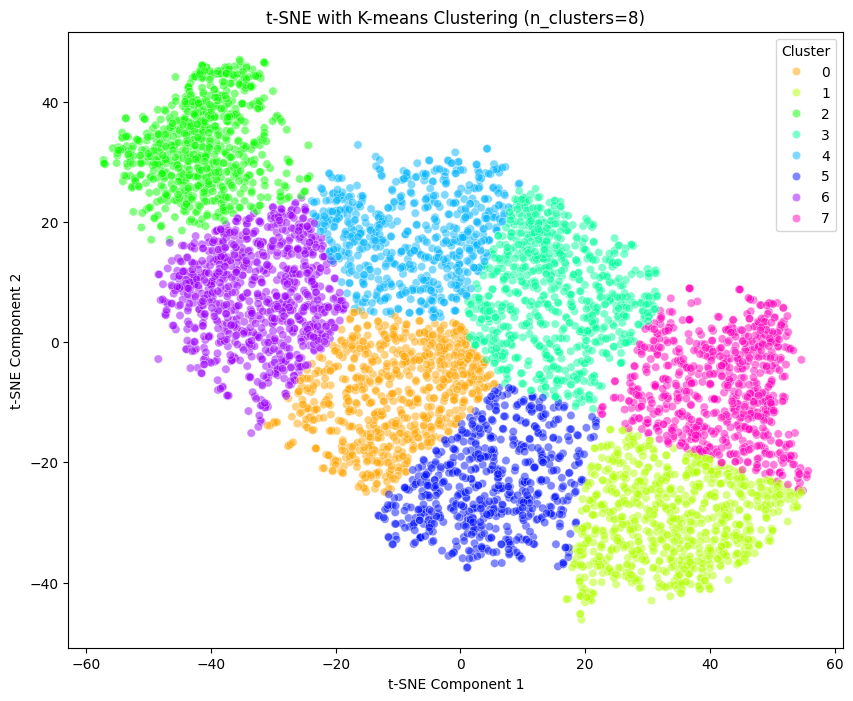

Silhouette Score for n_clusters=8: 0.3805450201034546


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


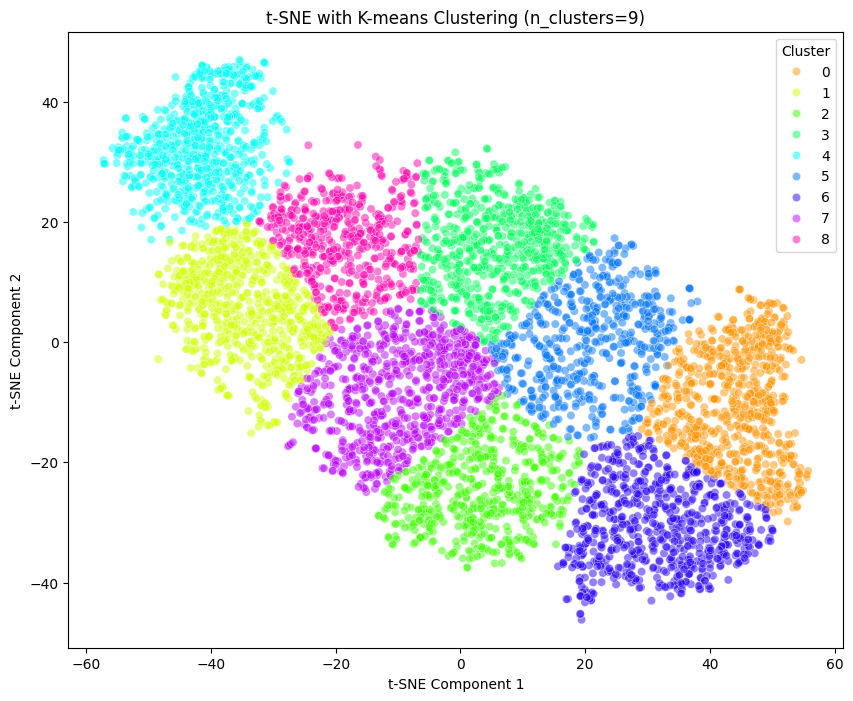

Silhouette Score for n_clusters=9: 0.3848729133605957


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


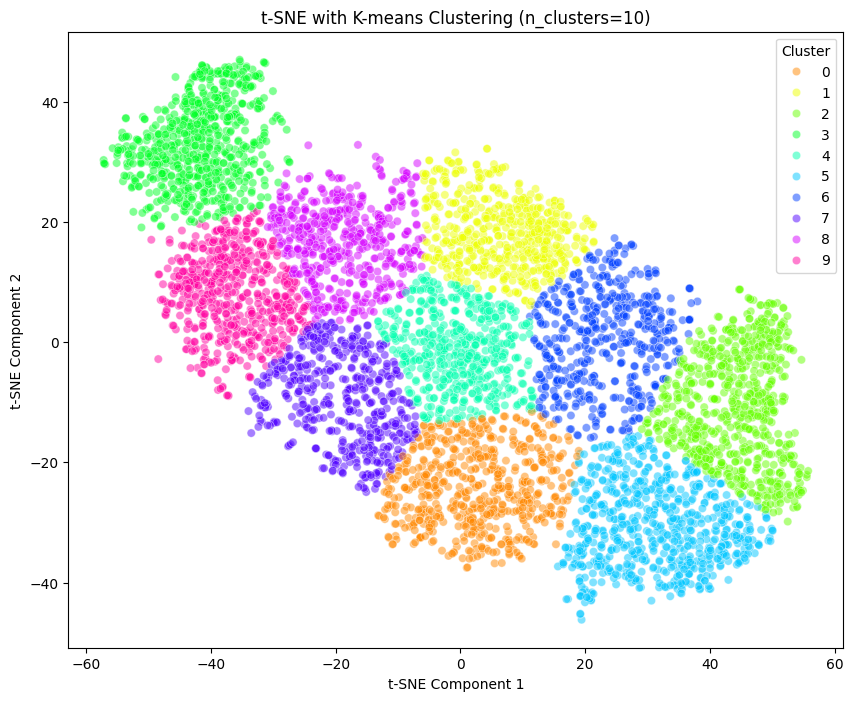

Silhouette Score for n_clusters=10: 0.3946928083896637


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


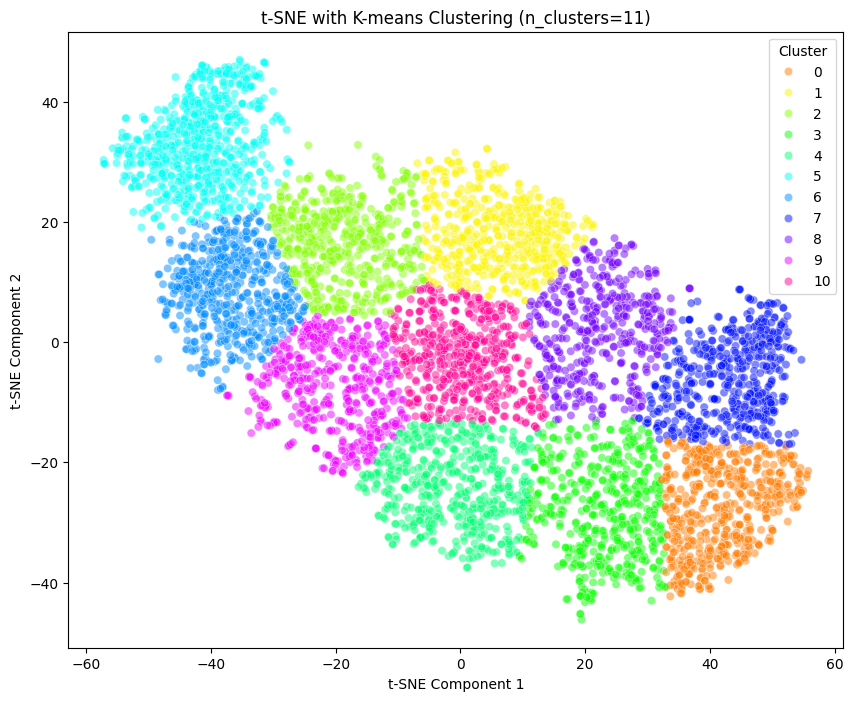

Silhouette Score for n_clusters=11: 0.38812926411628723


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


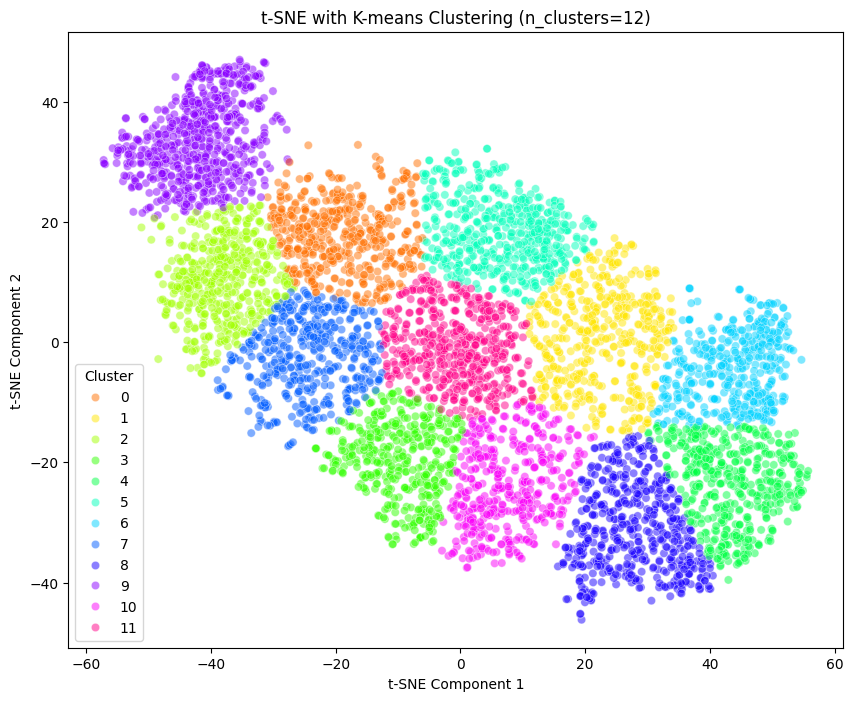

Silhouette Score for n_clusters=12: 0.38348084688186646


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


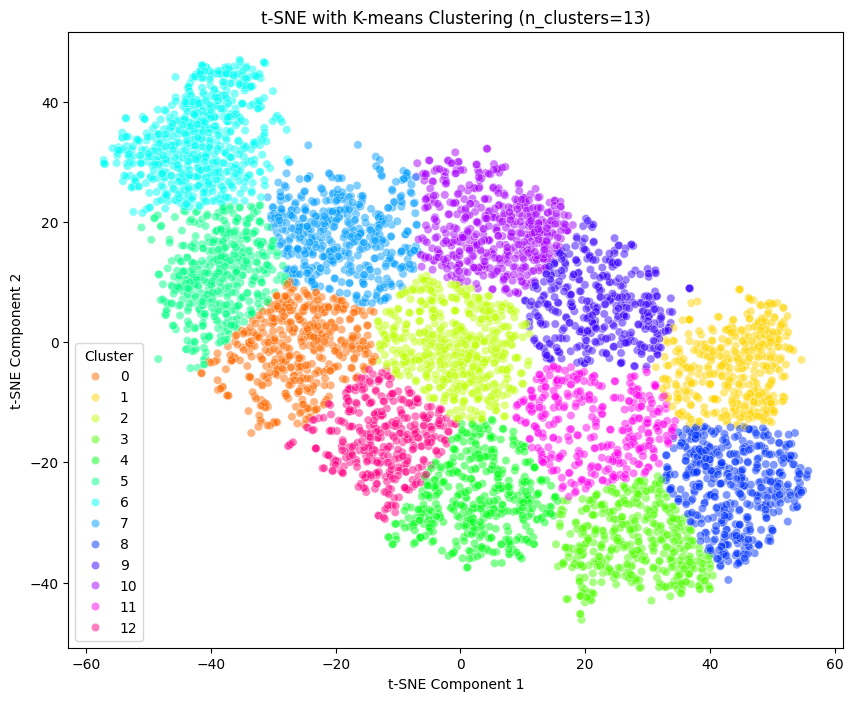

Silhouette Score for n_clusters=13: 0.3859774172306061


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


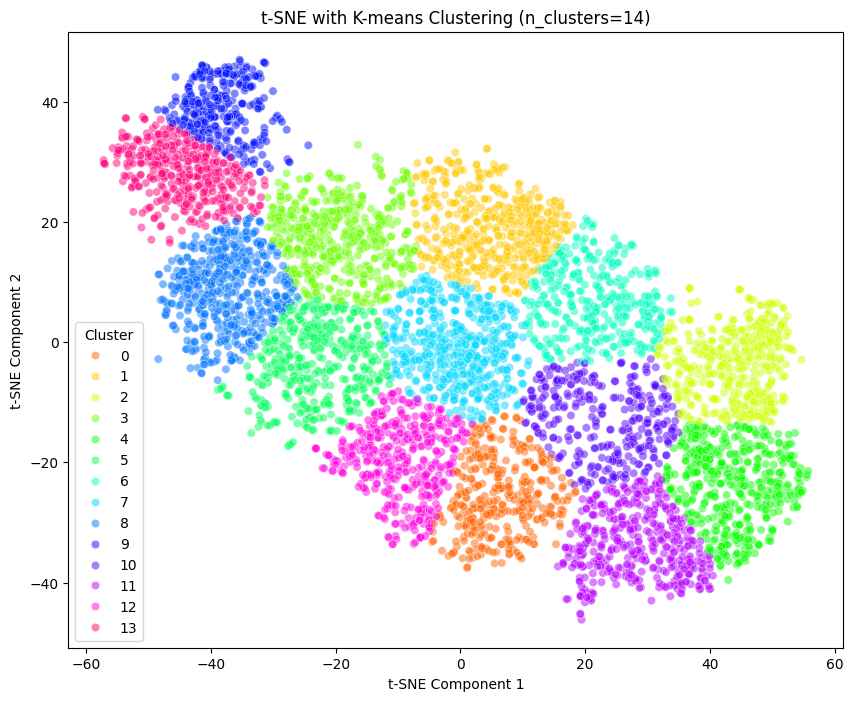

Silhouette Score for n_clusters=14: 0.371637761592865


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


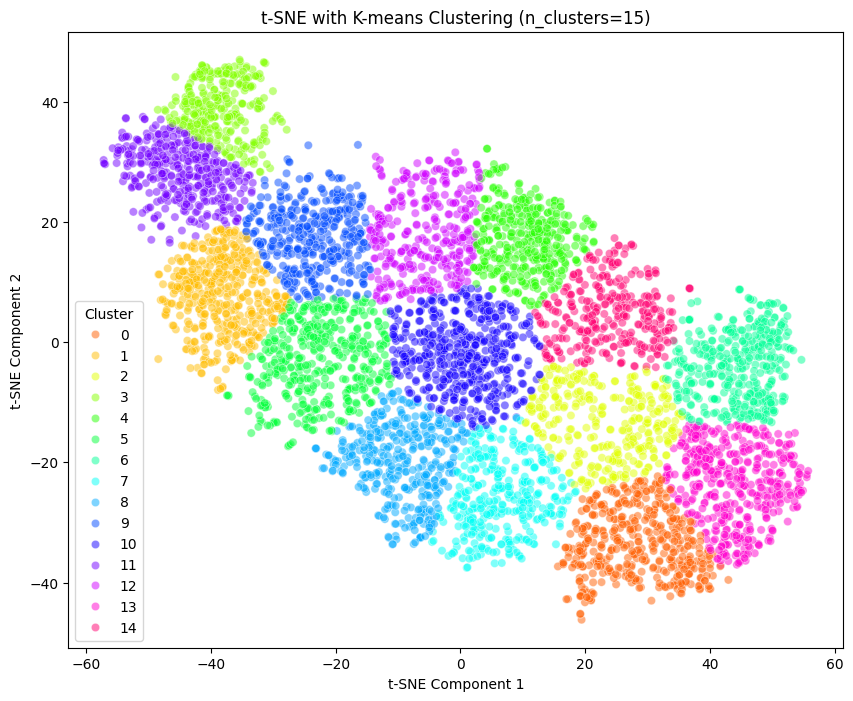

Silhouette Score for n_clusters=15: 0.3680958151817322


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


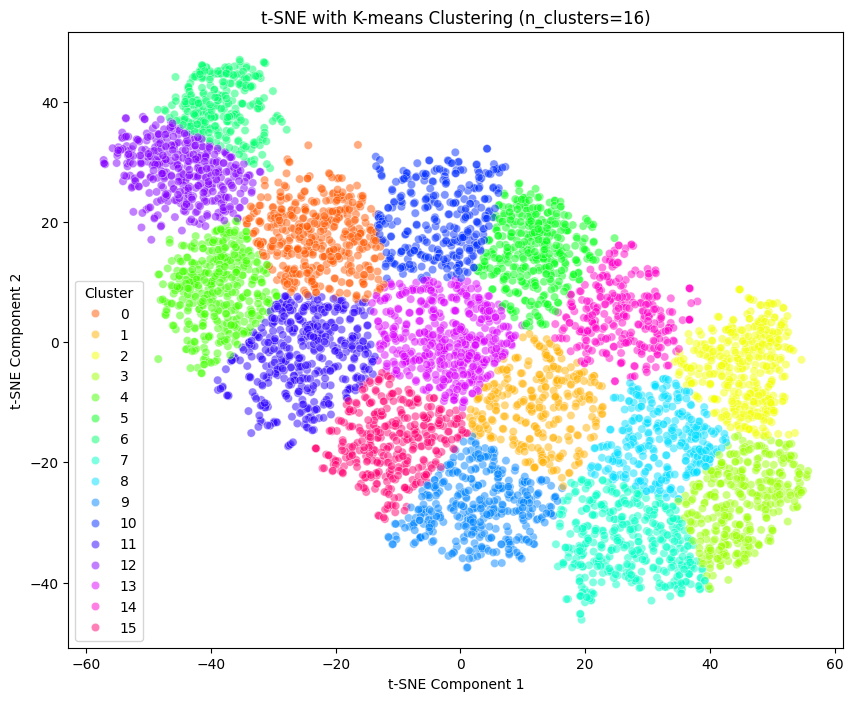

Silhouette Score for n_clusters=16: 0.36961960792541504


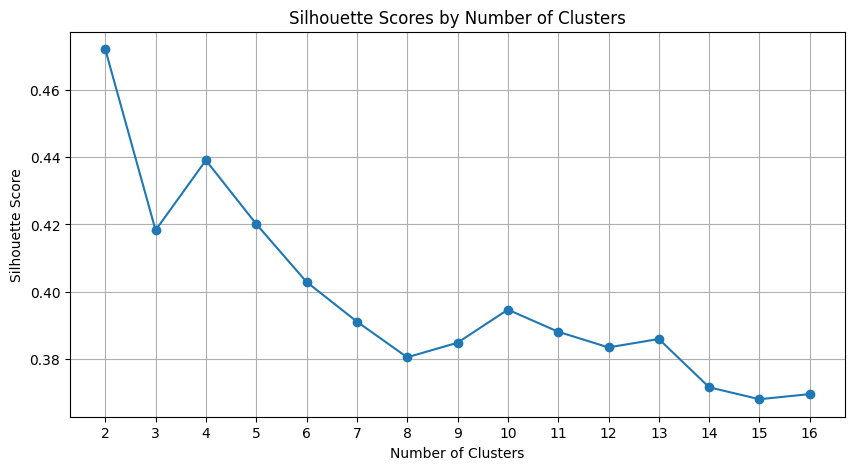

In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import numpy as np

# Assuming cnn_values is already obtained from your model outputs

# Set range of cluster numbers to evaluate
cluster_range = range(2, 17)  # for example, clusters from 2 to 16

# Prepare to collect silhouette scores
silhouette_scores = []

# Run t-SNE just once since it can be computationally expensive
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=50).fit_transform(cnn_values)

for n_clusters in cluster_range:
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
    cluster_labels = kmeans.labels_
    
    # Calculate Silhouette Score
    sil_score = silhouette_score(h_embedded, cluster_labels)
    silhouette_scores.append(sil_score)
    
    # Plotting t-SNE results with cluster colors
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
    plt.title(f"t-SNE with K-means Clustering (n_clusters={n_clusters})")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend(title='Cluster')
    plt.savefig(f'tsne_kmeans_{n_clusters}.png')  # Save the figure as PNG file
    plt.show()
    
    print(f"Silhouette Score for n_clusters={n_clusters}: {sil_score}")

# Plot all silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores by Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(cluster_range)
plt.grid(True)
plt.savefig('silhouette_scores.png')  # Save the silhouette scores plot
plt.show()


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/threadpoolctl.py:1010: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


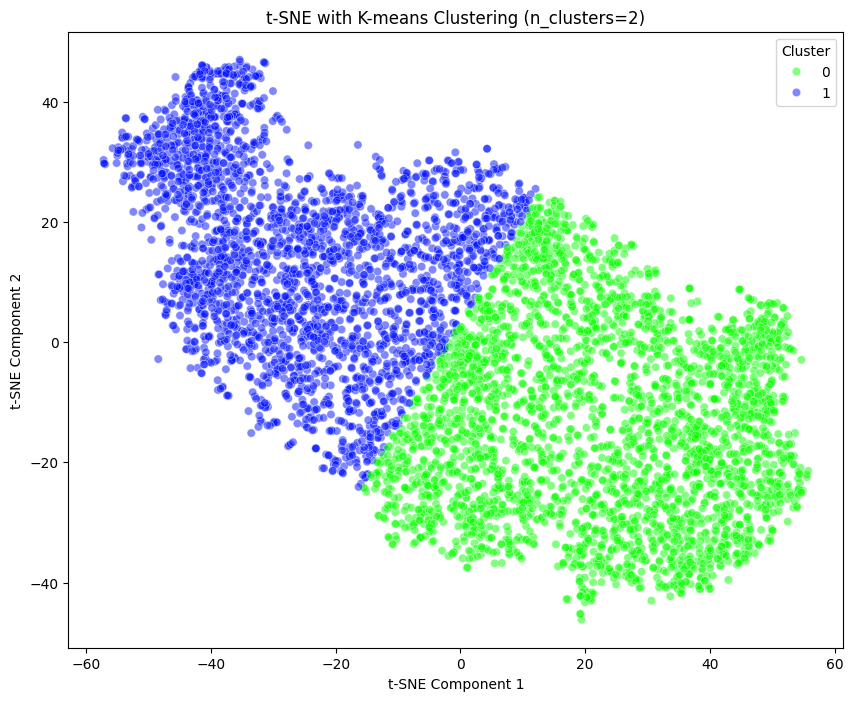

Silhouette Score for n_clusters=2: 0.4720141887664795


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


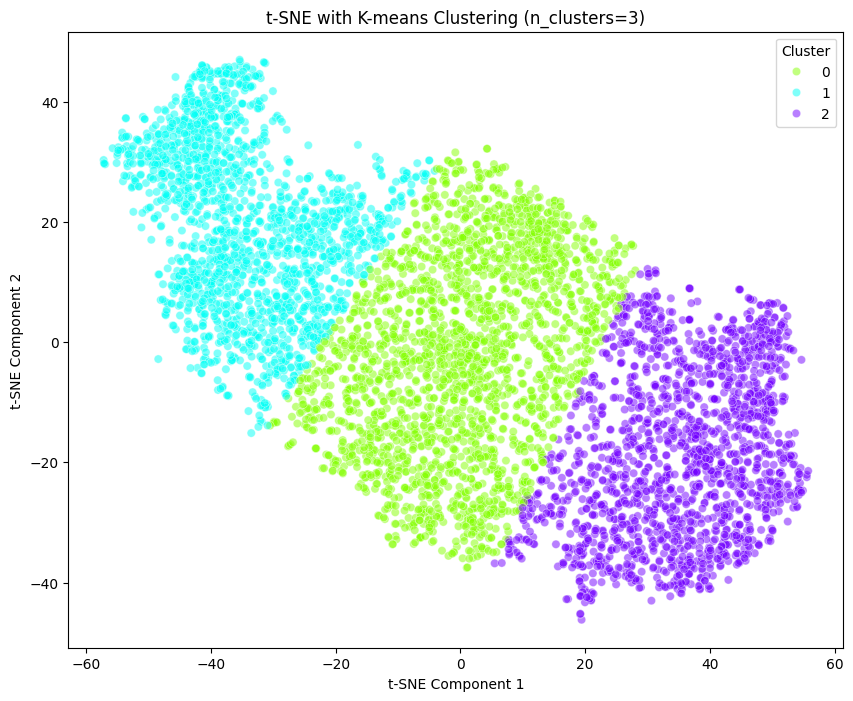

Silhouette Score for n_clusters=3: 0.418274462223053


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


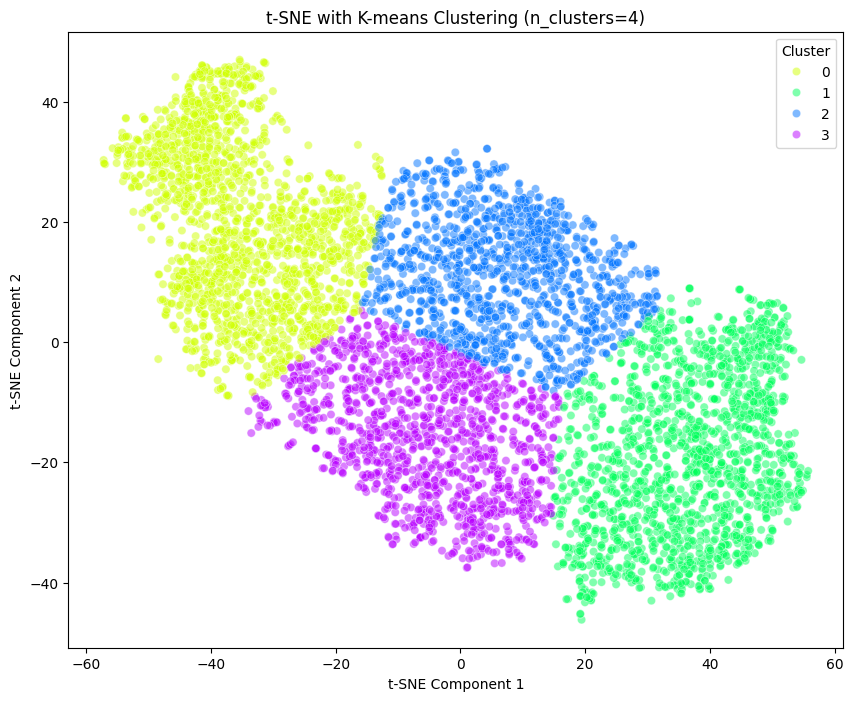

Silhouette Score for n_clusters=4: 0.4390401840209961


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


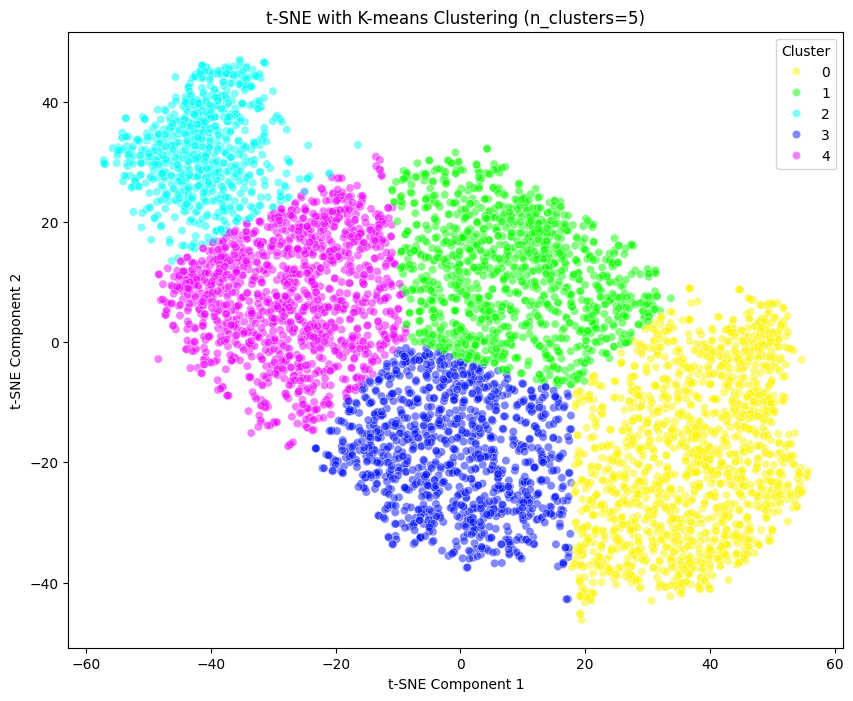

Silhouette Score for n_clusters=5: 0.4201204180717468


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


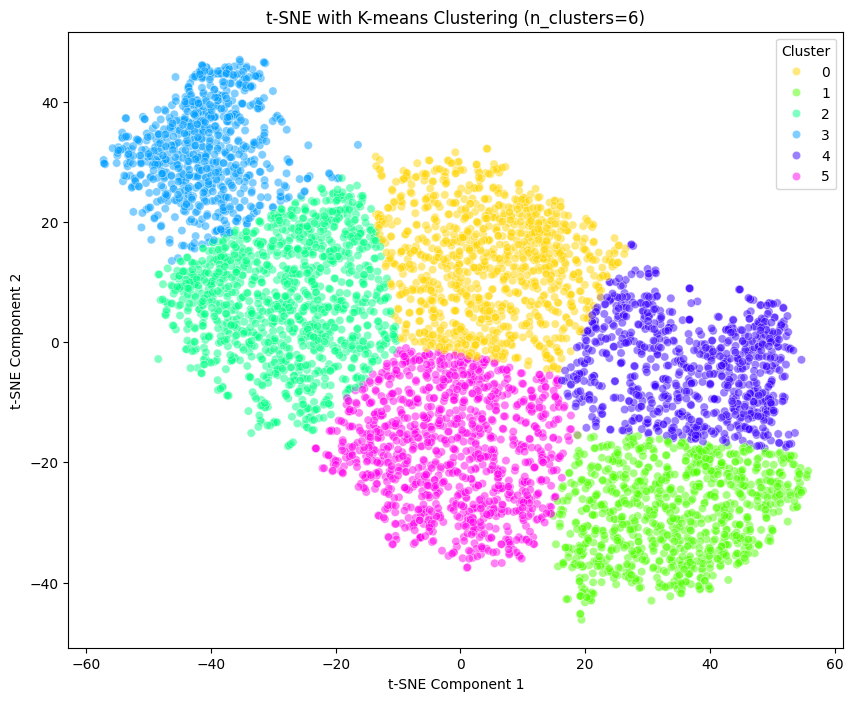

Silhouette Score for n_clusters=6: 0.40291741490364075


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


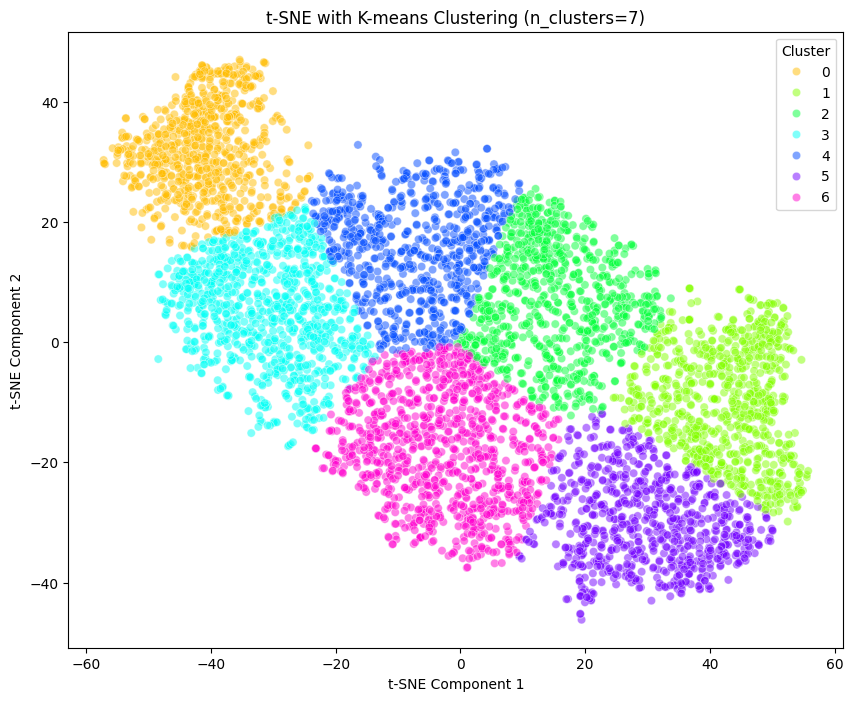

Silhouette Score for n_clusters=7: 0.39114630222320557


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


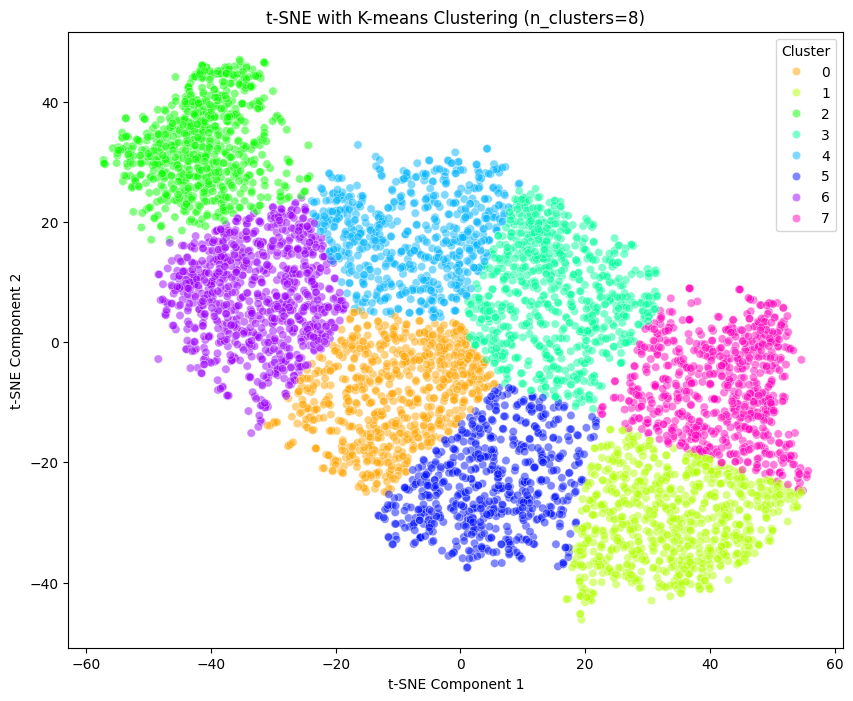

Silhouette Score for n_clusters=8: 0.3805450201034546


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


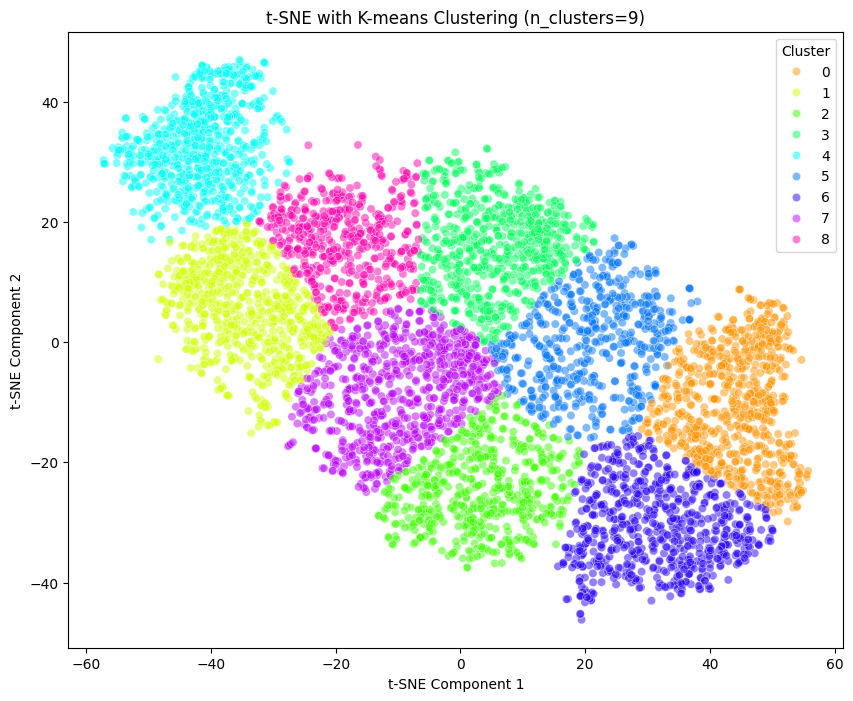

Silhouette Score for n_clusters=9: 0.3848729133605957


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


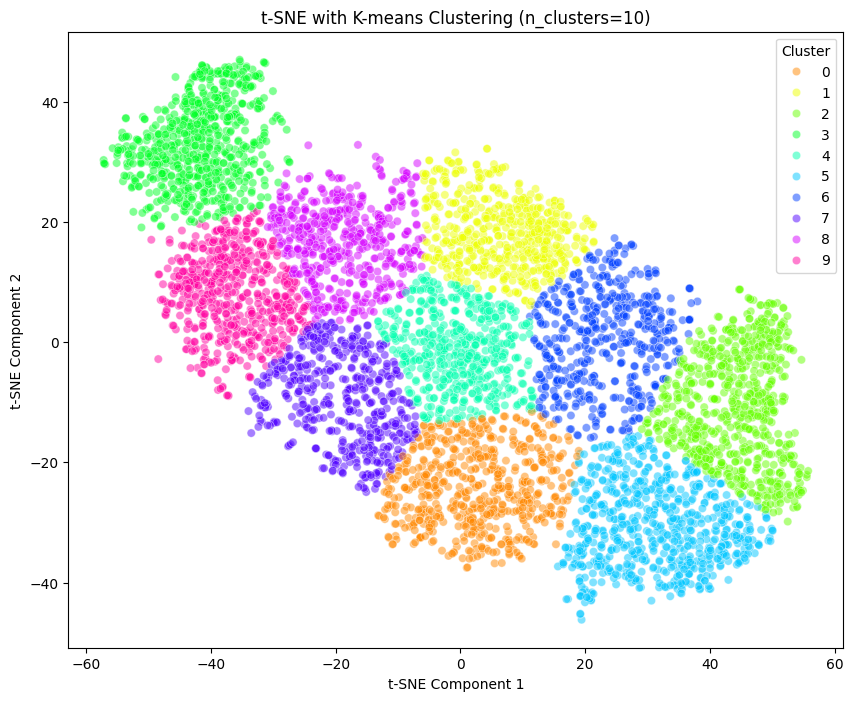

Silhouette Score for n_clusters=10: 0.3946928083896637


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


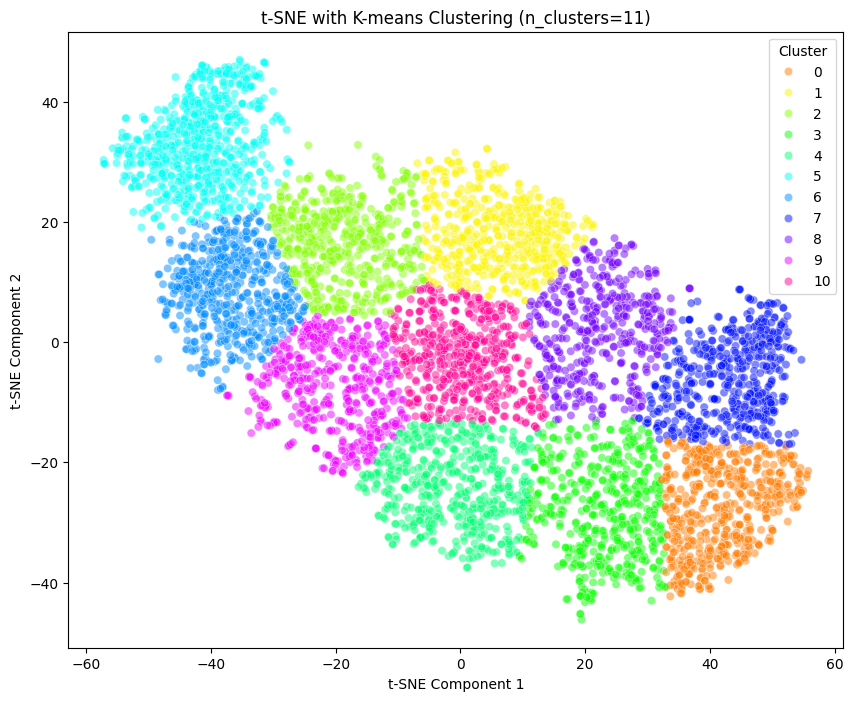

Silhouette Score for n_clusters=11: 0.38812926411628723


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


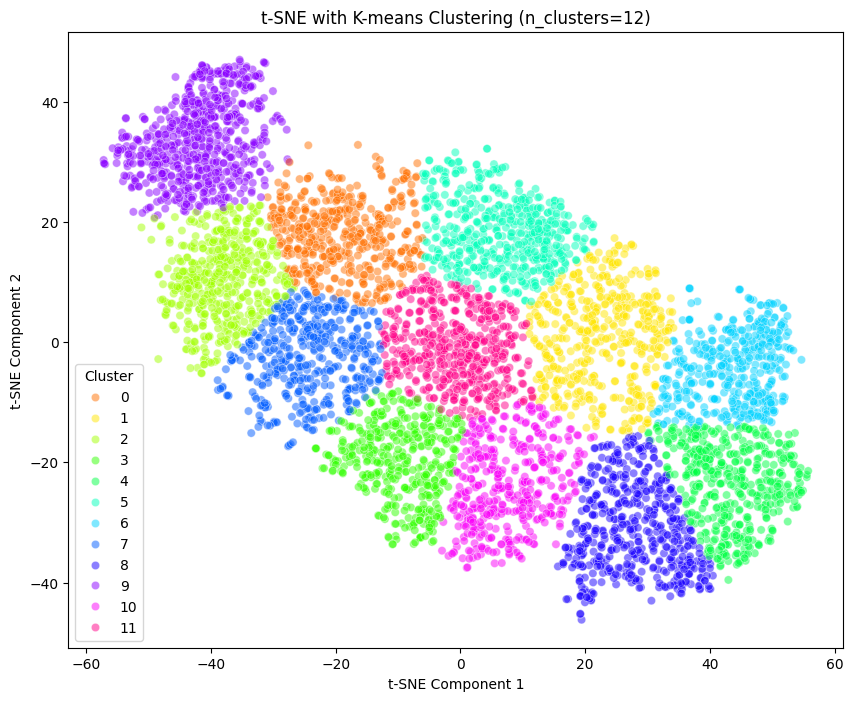

Silhouette Score for n_clusters=12: 0.38348084688186646


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


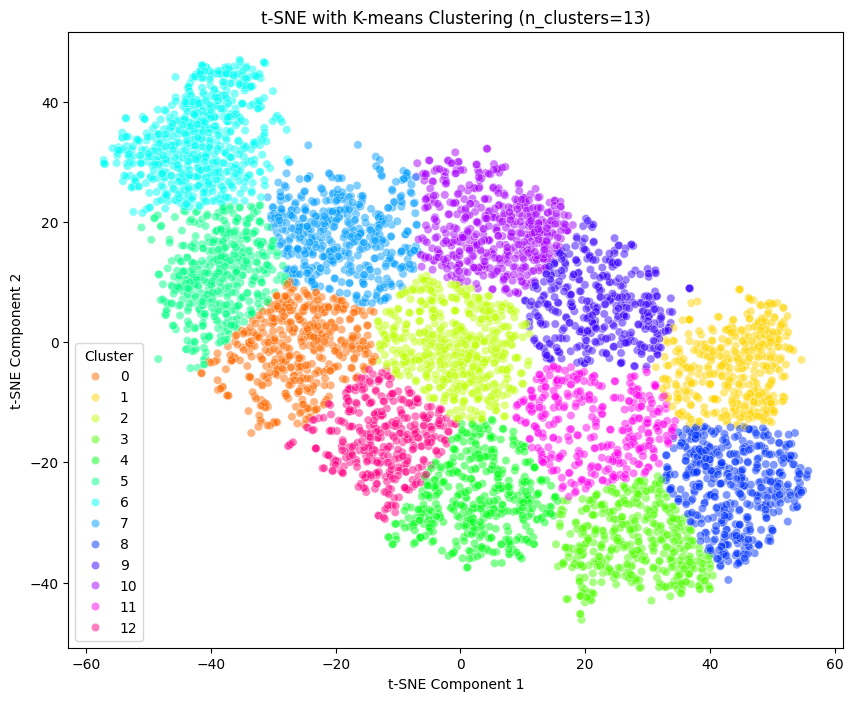

Silhouette Score for n_clusters=13: 0.3859774172306061


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


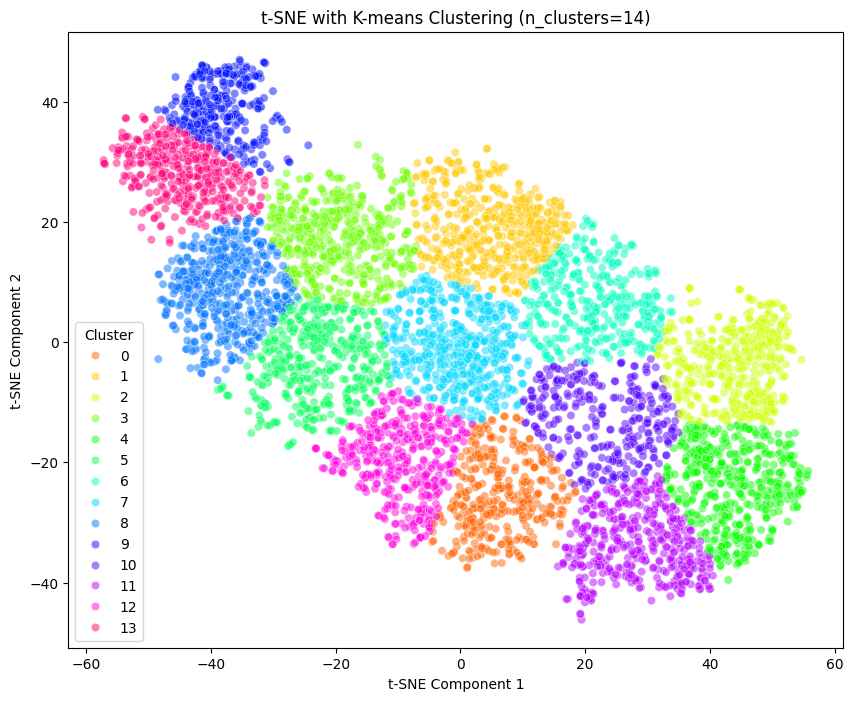

Silhouette Score for n_clusters=14: 0.371637761592865


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


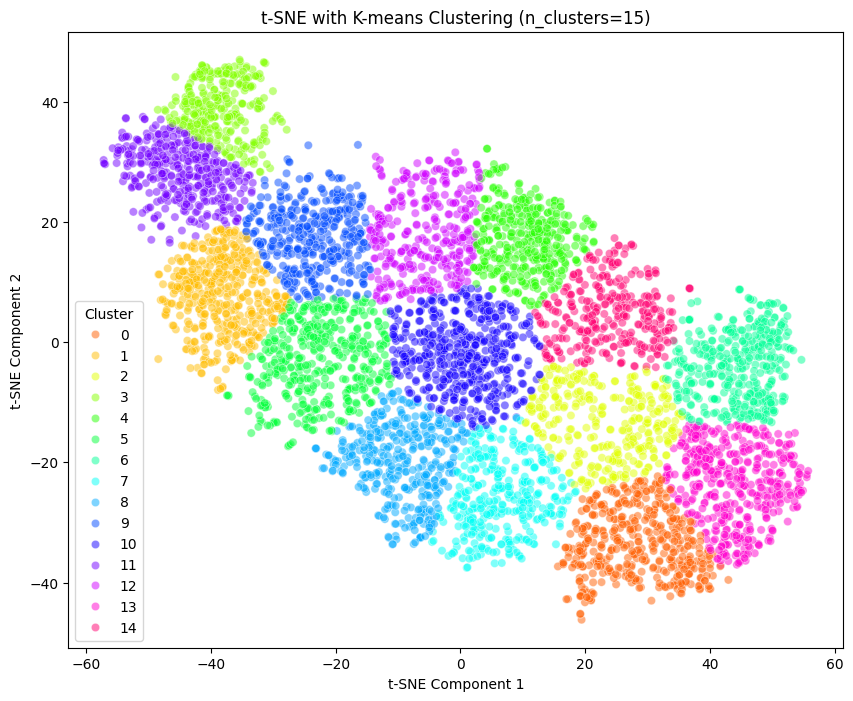

Silhouette Score for n_clusters=15: 0.3680958151817322


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


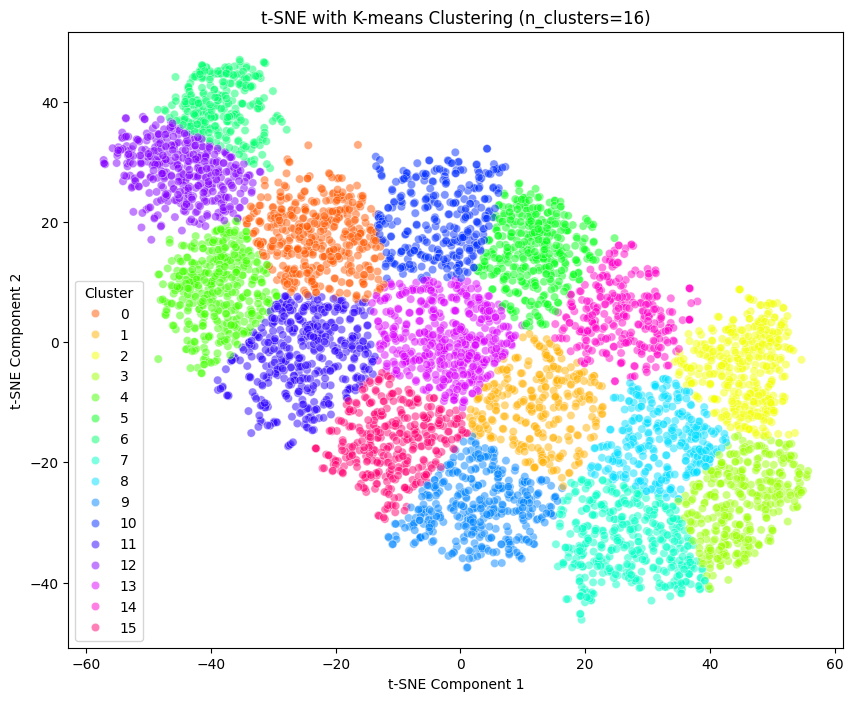

Silhouette Score for n_clusters=16: 0.36961960792541504


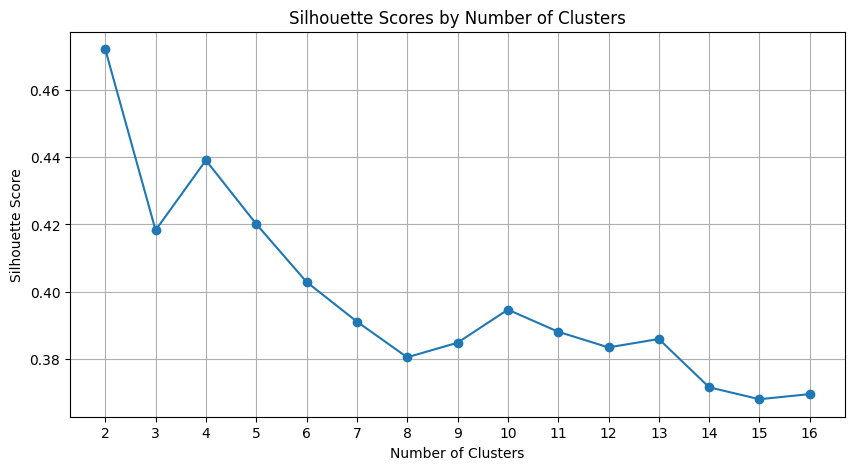

In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import numpy as np

# Assuming cnn_values is already obtained from your model outputs

# Set range of cluster numbers to evaluate
cluster_range = range(2, 17)  # for example, clusters from 2 to 16

# Prepare to collect silhouette scores
silhouette_scores = []

# Run t-SNE just once since it can be computationally expensive
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=50).fit_transform(cnn_values)

for n_clusters in cluster_range:
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
    cluster_labels = kmeans.labels_
    
    # Calculate Silhouette Score
    sil_score = silhouette_score(h_embedded, cluster_labels)
    silhouette_scores.append(sil_score)
    
    # Plotting t-SNE results with cluster colors
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
    plt.title(f"t-SNE with K-means Clustering (n_clusters={n_clusters})")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend(title='Cluster')
    plt.savefig(f'tsne_kmeans_{n_clusters}.png')  # Save the figure as PNG file
    plt.show()
    
    print(f"Silhouette Score for n_clusters={n_clusters}: {sil_score}")

# Plot all silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores by Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(cluster_range)
plt.grid(True)
plt.savefig('silhouette_scores.png')  # Save the silhouette scores plot
plt.show()


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/threadpoolctl.py:1010: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


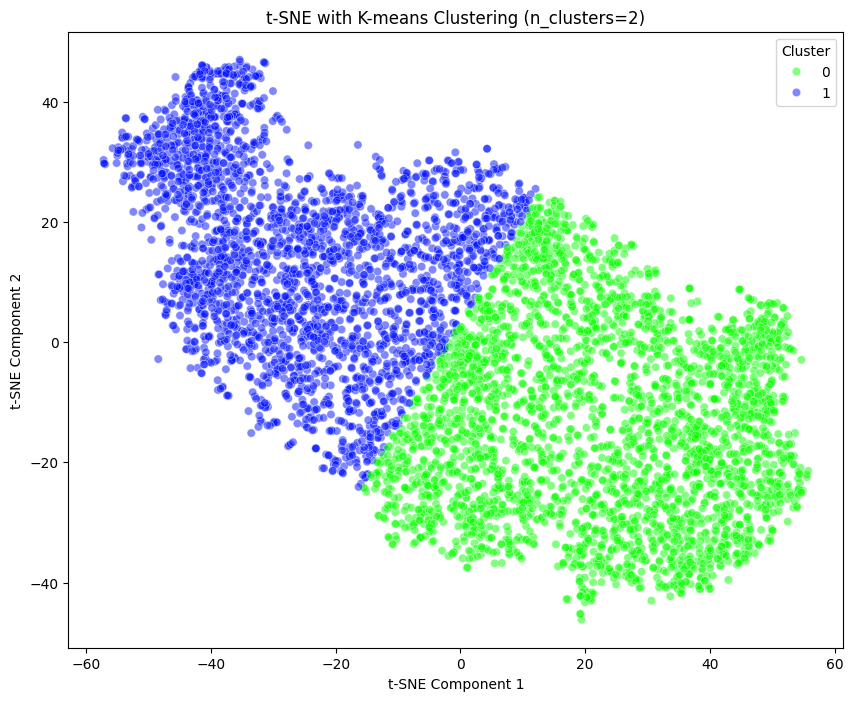

Silhouette Score for n_clusters=2: 0.4720141887664795


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


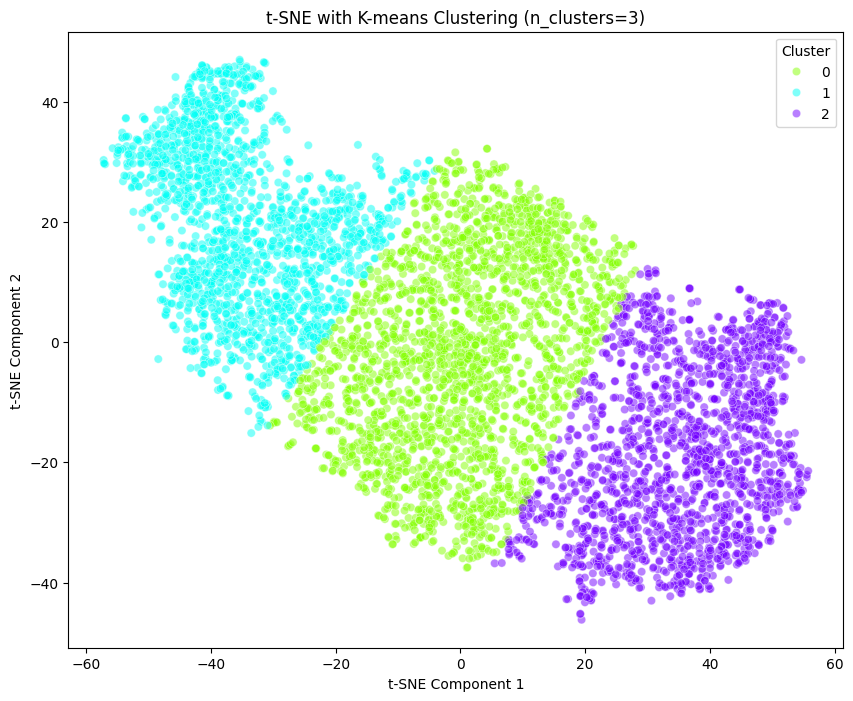

Silhouette Score for n_clusters=3: 0.418274462223053


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


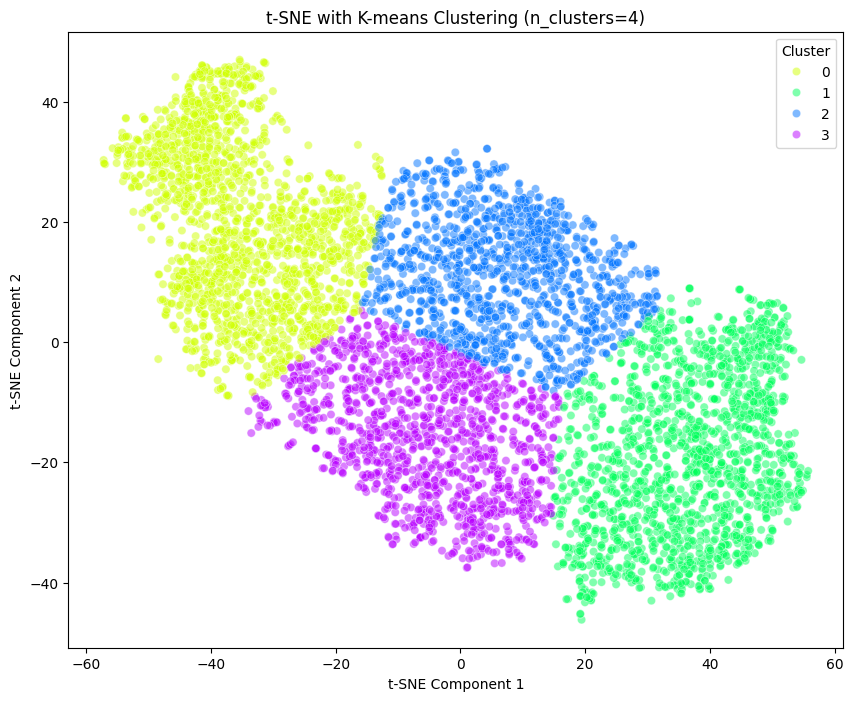

Silhouette Score for n_clusters=4: 0.4390401840209961


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


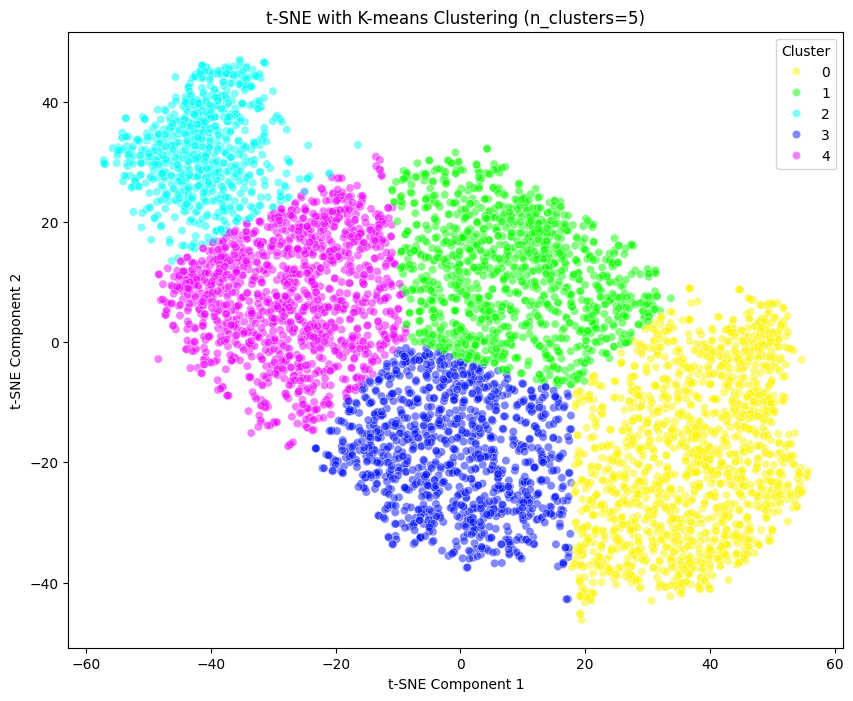

Silhouette Score for n_clusters=5: 0.4201204180717468


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


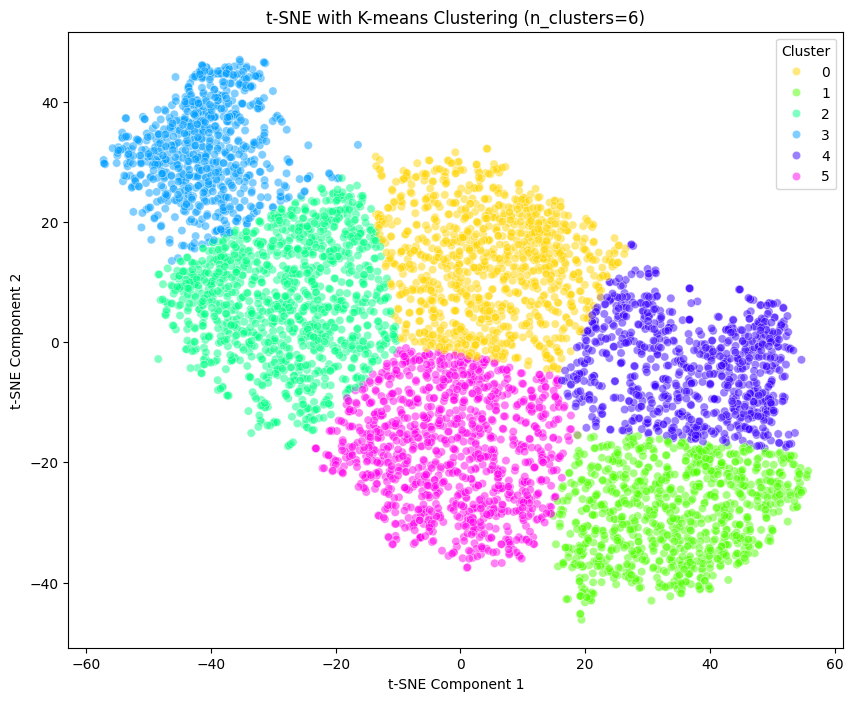

Silhouette Score for n_clusters=6: 0.40291741490364075


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


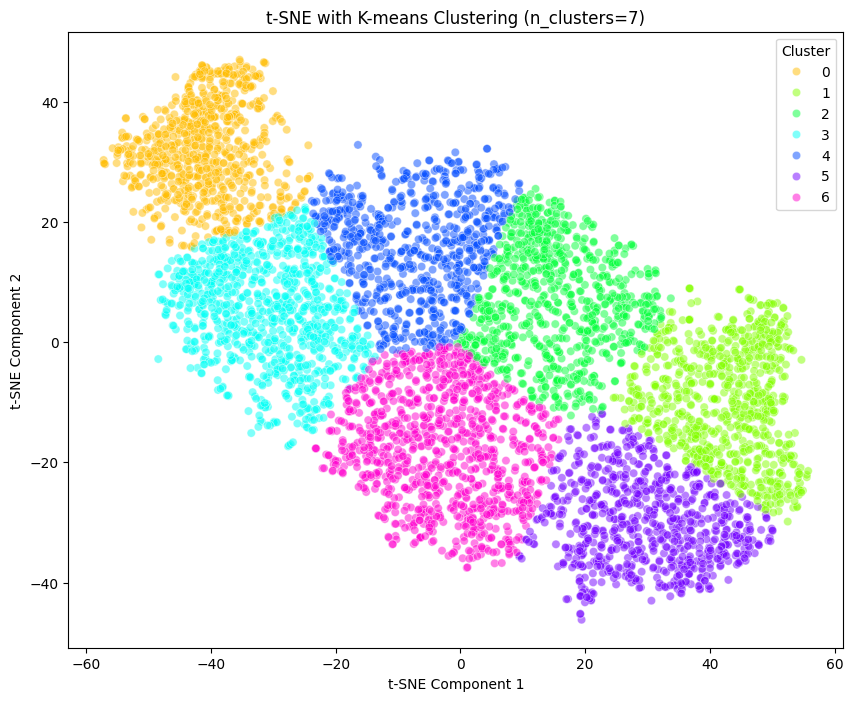

Silhouette Score for n_clusters=7: 0.39114630222320557


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


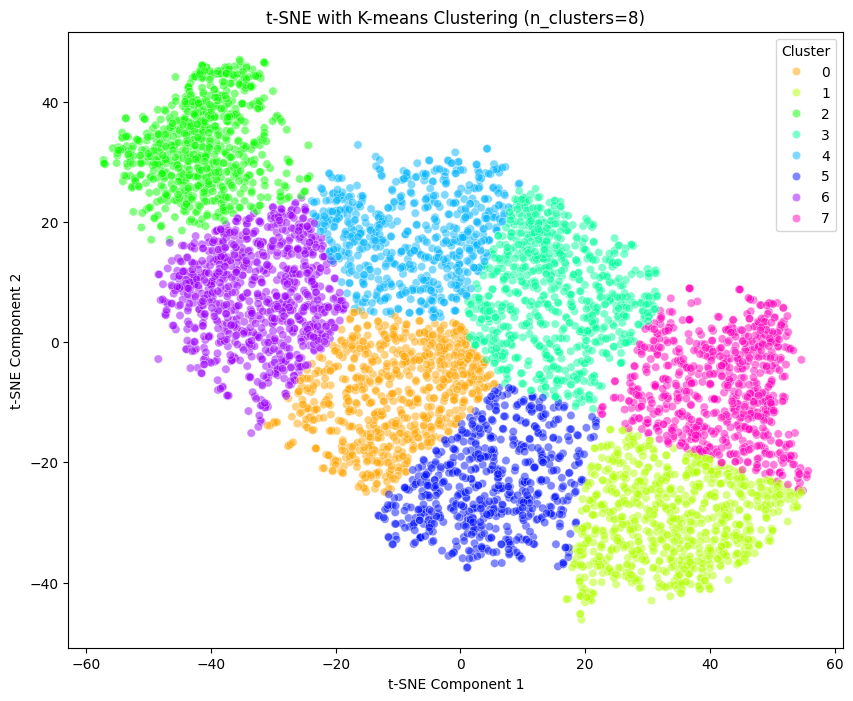

Silhouette Score for n_clusters=8: 0.3805450201034546


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


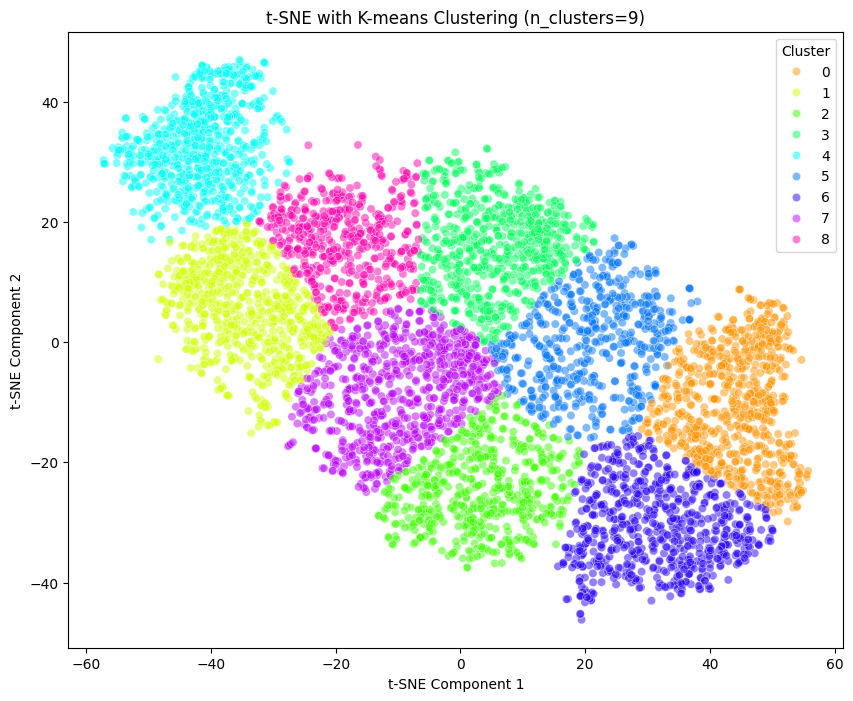

Silhouette Score for n_clusters=9: 0.3848729133605957


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


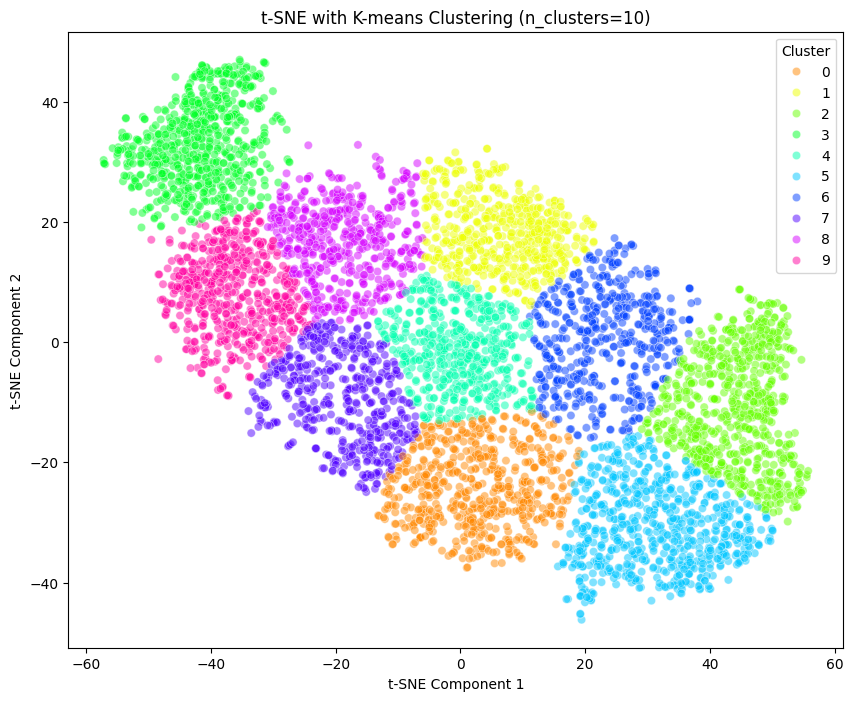

Silhouette Score for n_clusters=10: 0.3946928083896637


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


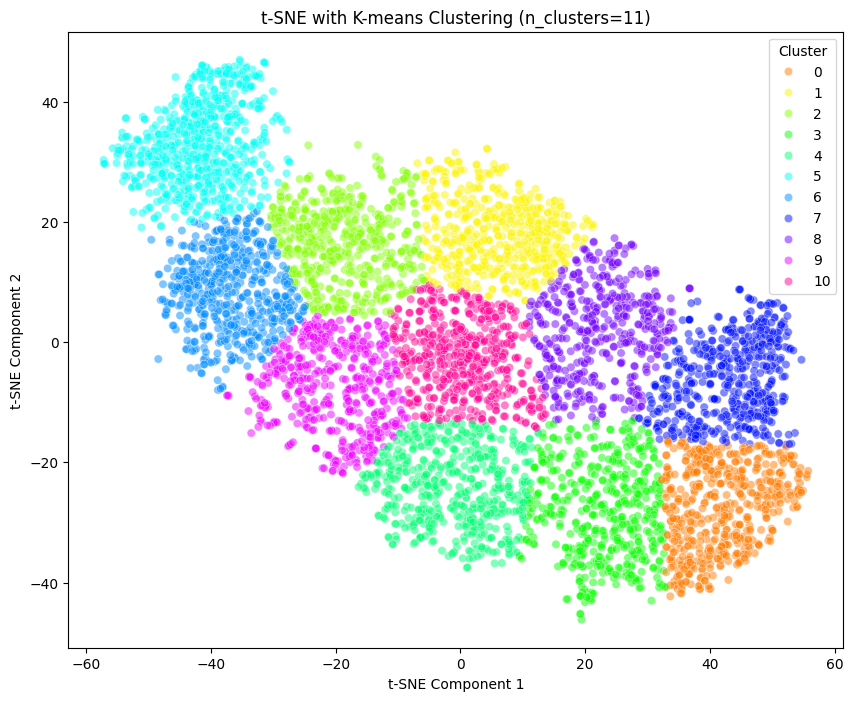

Silhouette Score for n_clusters=11: 0.38812926411628723


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


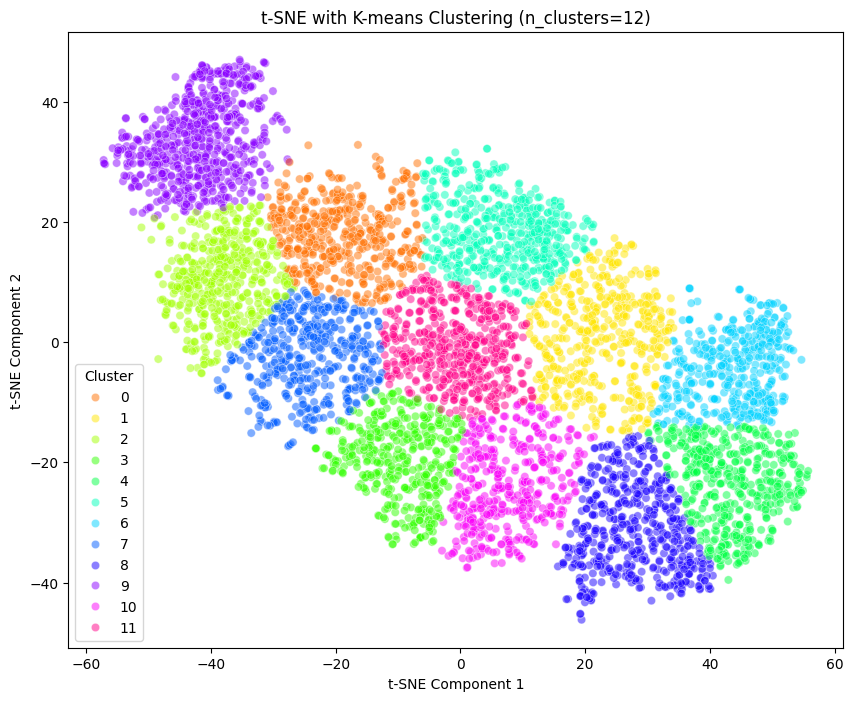

Silhouette Score for n_clusters=12: 0.38348084688186646


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


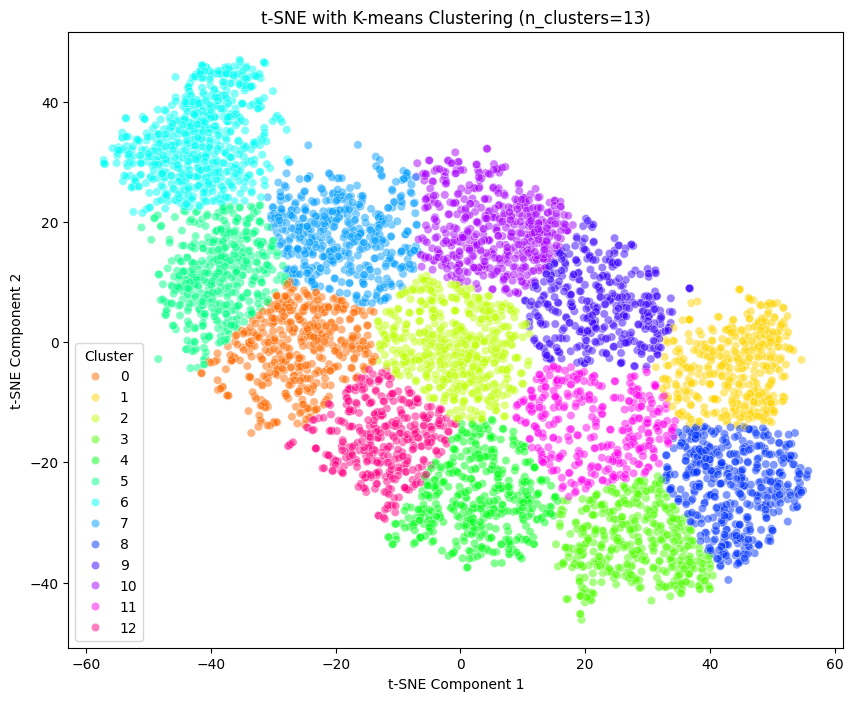

Silhouette Score for n_clusters=13: 0.3859774172306061


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


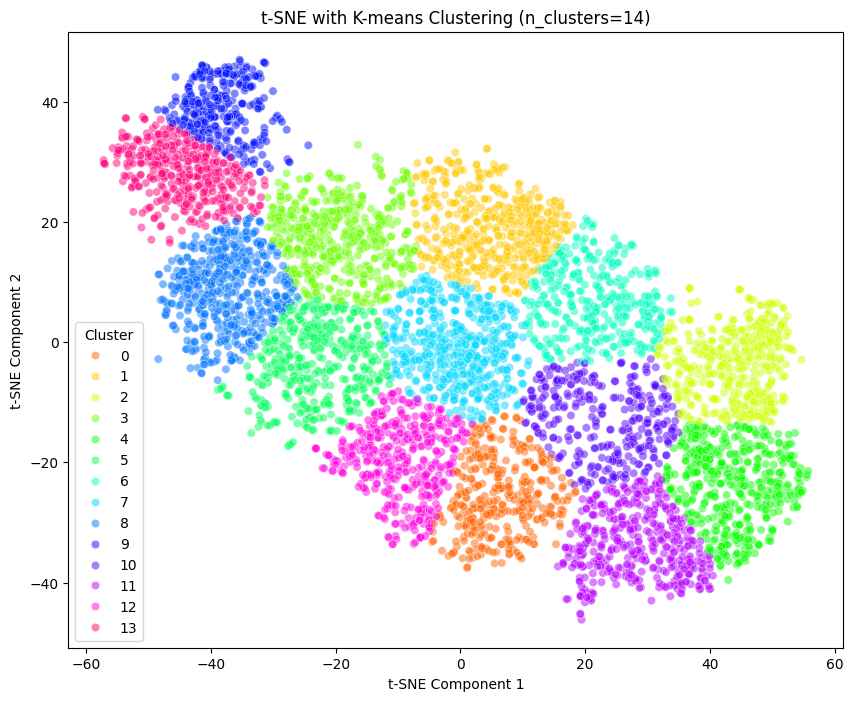

Silhouette Score for n_clusters=14: 0.371637761592865


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


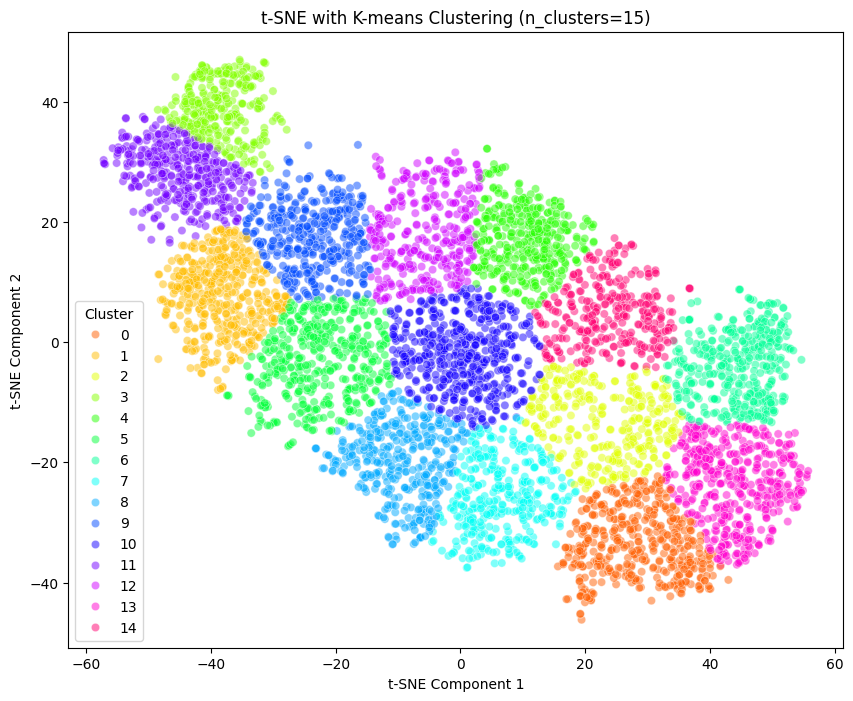

Silhouette Score for n_clusters=15: 0.3680958151817322


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


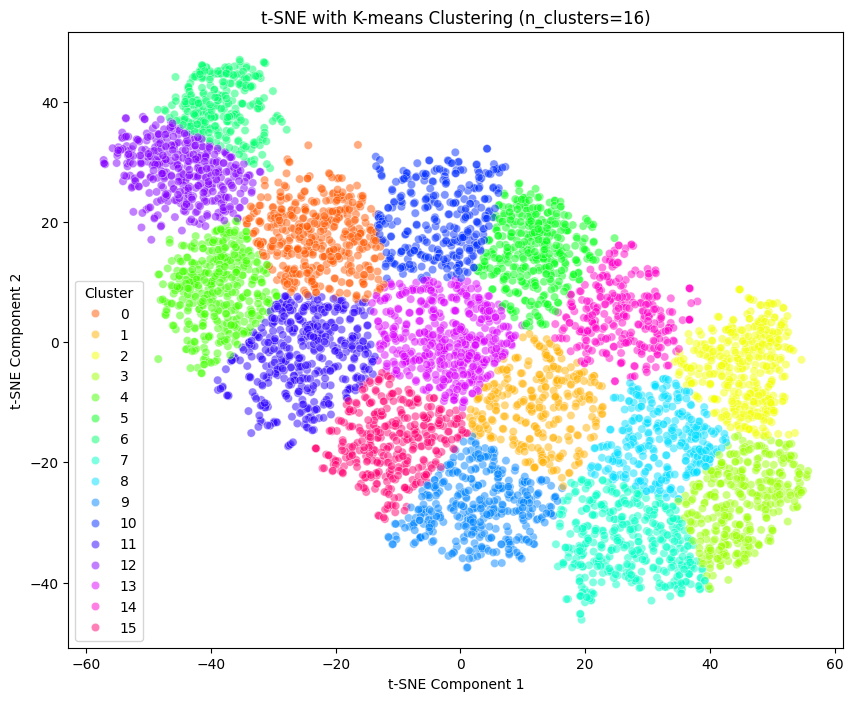

Silhouette Score for n_clusters=16: 0.36961960792541504


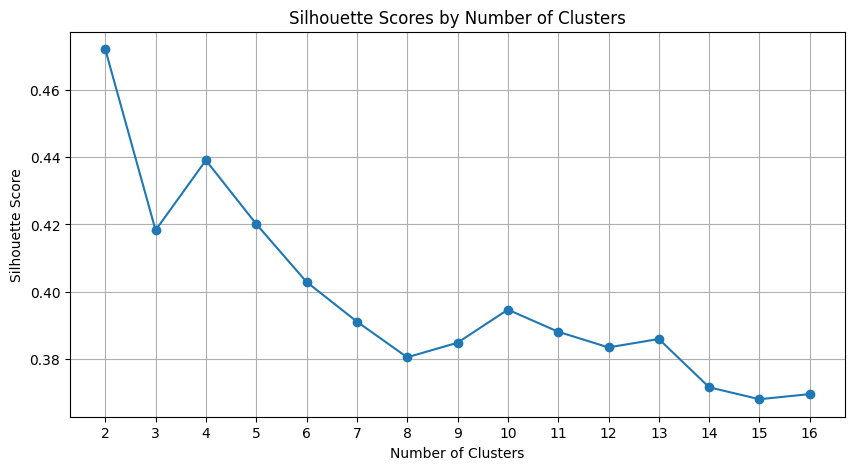

In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import numpy as np

# Assuming cnn_values is already obtained from your model outputs

# Set range of cluster numbers to evaluate
cluster_range = range(2, 17)  # for example, clusters from 2 to 16

# Prepare to collect silhouette scores
silhouette_scores = []

# Run t-SNE just once since it can be computationally expensive
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=50).fit_transform(cnn_values)

for n_clusters in cluster_range:
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
    cluster_labels = kmeans.labels_
    
    # Calculate Silhouette Score
    sil_score = silhouette_score(h_embedded, cluster_labels)
    silhouette_scores.append(sil_score)
    
    # Plotting t-SNE results with cluster colors
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
    plt.title(f"t-SNE with K-means Clustering (n_clusters={n_clusters})")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend(title='Cluster')
    plt.savefig(f'tsne_kmeans_{n_clusters}.png')  # Save the figure as PNG file
    plt.show()
    
    print(f"Silhouette Score for n_clusters={n_clusters}: {sil_score}")

# Plot all silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores by Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(cluster_range)
plt.grid(True)
plt.savefig('silhouette_scores.png')  # Save the silhouette scores plot
plt.show()


In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
import torch

# Assuming all_outputs is already obtained as in your provided code

# Run t-SNE
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=500).fit_transform(cnn_values)

# Perform k-means clustering on the t-SNE embeddings
n_clusters = 17 # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
cluster_labels = kmeans.labels_

# Plot
plt.figure(figsize=(10, 8))  # Optional: Adjust the figure size as needed
sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
plt.title("t-SNE with K-means Clustering")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='Cluster')
plt.show()

In [ ]:
label_values

In [8]:
import pandas as pd

# Assuming `song_names` and `cluster_labels` are defined and correspond to each other
if len(label_values) != len(cluster_labels):
    raise ValueError("The length of song_names must match the length of all_outputs")

# Create a DataFrame to store song names and their corresponding cluster labels
data = pd.DataFrame({
    'Song Name': label_values,
    'Cluster Label': cluster_labels
})

# Sort the DataFrame by 'Cluster Label'
data_sorted = data.sort_values(by='Cluster Label')

# Write the sorted DataFrame to a text file
data_sorted.to_csv('song_clusters_sorted.csv', index=False, sep='\t')  # Using tab as separator


In [8]:
import pandas as pd

# Load the data from CSV file
df = pd.read_csv('song_clusters_sorted.csv')

# Replace underscores and dashes in the 'Song Name' column
df[df.columns[0]] = df[df.columns[0]].str.replace('_', ' ').str.replace('-', ' ')

# Save the modified dataframe back to a CSV file
df.to_csv('song_modified.csv', index=False)


In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import numpy as np
import pandas as pd

# Assuming cnn_values and song_names are already obtained from your model outputs

# Set range of cluster numbers to evaluate
cluster_range = range(2, 17)  # for example, clusters from 2 to 16

# Prepare to collect silhouette scores
silhouette_scores = []

# Run t-SNE just once since it can be computationally expensive
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=50).fit_transform(cnn_values)

for n_clusters in cluster_range:
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
    cluster_labels = kmeans.labels_
    
    # Calculate Silhouette Score
    sil_score = silhouette_score(h_embedded, cluster_labels)
    silhouette_scores.append(sil_score)
    
    # Plotting t-SNE results with cluster colors
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
    plt.title(f"t-SNE with K-means Clustering (n_clusters={n_clusters})")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend(title='Cluster')
    # plt.show()
    
    print(f"Silhouette Score for n_clusters={n_clusters}: {sil_score}")

    # Create a DataFrame to store song names and their corresponding cluster labels
    if len(song_names) != len(cluster_labels):
        raise ValueError("The length of song_names must match the length of cluster_labels")

    data = pd.DataFrame({
        'Song Name': song_names,
        'Cluster Label': cluster_labels
    })

    # Write the DataFrame to a CSV file, one for each cluster number
    data.to_csv(f'song_clusters_k{n_clusters}.csv', index=False, sep='\t')  # Using tab as separator

# Plot all silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores by Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.xticks(cluster_range)
plt.grid(True)
plt.show()


In [13]:
data_sorted

,Song Name,Cluster Label
4688,Taylor_Swift_-_ME,0
231,Soulja_Boy_-_Kiss_Me_Thru_The_Phone,0
230,Ariana_Grande_-_Stuck_with_U,0
705,Selena_Gomez_-_Same_Old_Love,0
2290,Calboy_-_Envy_Me,0
...,...,...
2737,Bryan_Adams_-_I_Do_It_For_You,16
2729,Eminem_-_Berzerk,16
463,Shania_Twain_-_Youre_Still_The_One,16
443,Adele_-_Water_Under_The_Bridge,16


For n_clusters = 2, the average silhouette score is: 0.18006978929042816
For n_clusters = 3, the average silhouette score is: 0.11816228181123734
For n_clusters = 4, the average silhouette score is: 0.1136685162782669
For n_clusters = 5, the average silhouette score is: 0.10348748415708542
For n_clusters = 6, the average silhouette score is: 0.08319421112537384
For n_clusters = 7, the average silhouette score is: 0.08254145085811615
For n_clusters = 8, the average silhouette score is: 0.08021201193332672
For n_clusters = 9, the average silhouette score is: 0.07423242926597595
For n_clusters = 10, the average silhouette score is: 0.07444970309734344
For n_clusters = 11, the average silhouette score is: 0.07438673079013824
For n_clusters = 12, the average silhouette score is: 0.07509622722864151
For n_clusters = 13, the average silhouette score is: 0.07167377322912216
For n_clusters = 14, the average silhouette score is: 0.07186216861009598
For n_clusters = 15, the average silhouette sco

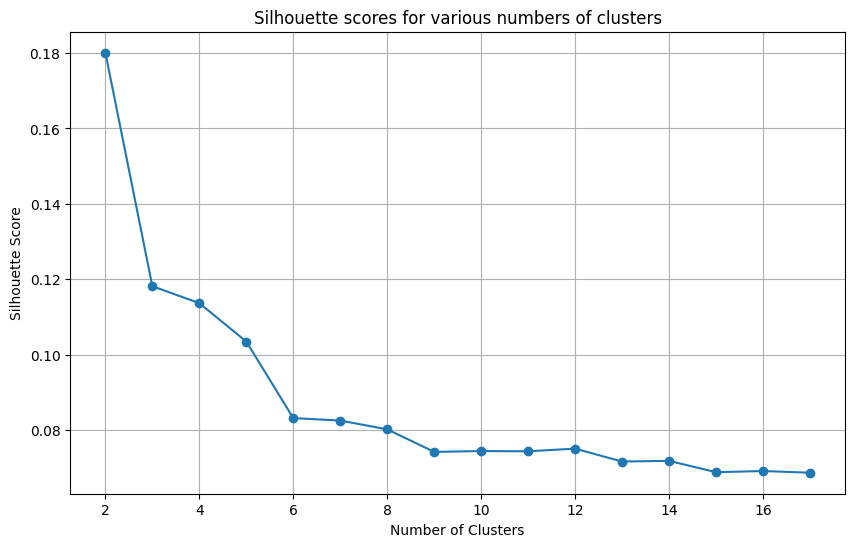

In [6]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
range_n_clusters = list(range(2, 18))  # for example, from 2 to 10 clusters

silhouette_avg_scores = []

for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(cnn_values)
    
    # Calculate the silhouette score and append to the list
    silhouette_avg = silhouette_score(cnn_values, cluster_labels)
    silhouette_avg_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the average silhouette score is: {silhouette_avg}")

plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, silhouette_avg_scores, marker='o')
plt.title('Silhouette scores for various numbers of clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

Silhouette Score: 0.3854331970214844


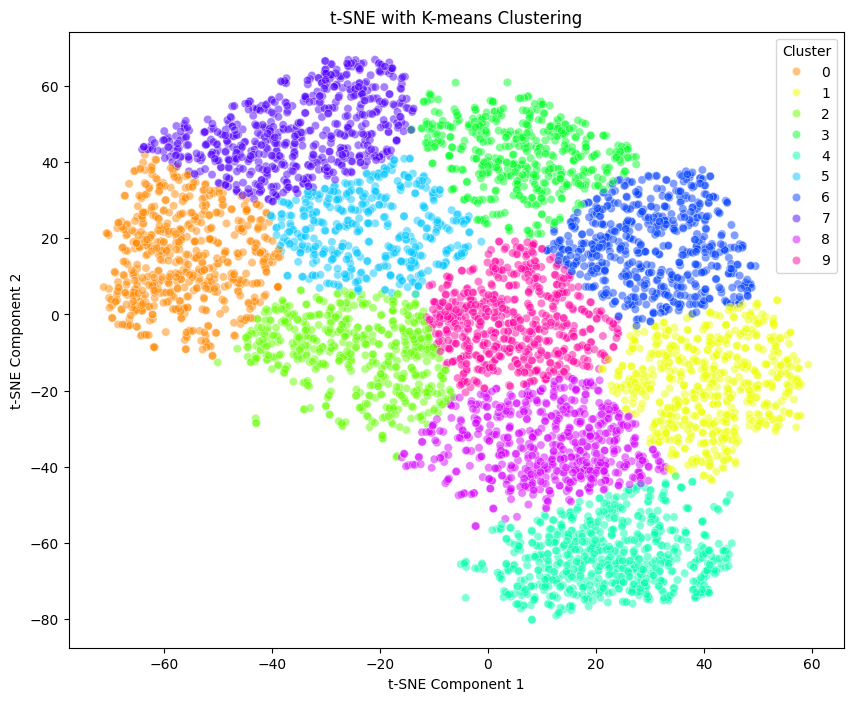

In [10]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score  # Import silhouette_score function
import torch

# Assuming all_outputs is already obtained as in your provided code

# Run t-SNE
h_embedded = TSNE(n_components=2, learning_rate='auto', init='random', perplexity=25).fit_transform(cnn_values)

# Perform k-means clustering on the t-SNE embeddings
n_clusters = 10 # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(h_embedded)
cluster_labels = kmeans.labels_

# Calculate Silhouette Score
sil_score = silhouette_score(h_embedded, cluster_labels)
print(f"Silhouette Score: {sil_score}")

# Plot
plt.figure(figsize=(10, 8))  # Optional: Adjust the figure size as needed
sns.scatterplot(x=h_embedded[:, 0], y=h_embedded[:, 1], hue=cluster_labels, alpha=0.5, palette=sns.color_palette("hsv", n_clusters))
plt.title("t-SNE with K-means Clustering")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='Cluster')
plt.show()


In [8]:
data_sorted=pd.read_csv("Clusters/song_clusters_k13.csv")
data_sorted = data_sorted.sort_values(by=data_sorted.columns[1])

# Write the sorted DataFrame to a text file
data_sorted.to_csv('Clusters/song_clusters_k13.csv')  # Using tab as separator


KeyError: 'Cluster Label'